# Inputs

- Info to track record about each experiment

In [1]:
date = '22-03-2021'
name = 'basic'
description = '''
As increasing the number of clusters the error in the prediction decreases. The objective is to increase the number of AEs in those areas where the variability is higher (usually crops). For that the mean, max, min values for each cluster will be calculated and the most variable clusters will be reclustered.
Note that in the case of Strobler the most variable clusters are forest.
'''

- Technical inputs

In [2]:
area = 'Strobler'
path_images = f'/home/boku/autoencoders/images/{area}/'
bands = ['Cloud','B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B10', 'B11', 'B12']
directory = 'experiment' #updated, experiment or tuning
experiment_name = 'reclustering'
n_pixels = 1
n_clusters = 8
n_hidden_neurons = 10
no_hazzy_images = True

- Modify in the code:
    - path test image
    - YMD test image
    - hazzy images list
    - vmin vmax colormap prediction errors

# Libraries

In [3]:
'''Main'''
import numpy as np
import pandas as pd
import os, time, re
import pickle, gzip
from random import randint
import math
import re
import random

'''Data Viz'''
import matplotlib.pyplot as plt
from matplotlib.pyplot import hist
import matplotlib.cm as cm
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl

%matplotlib inline

'''Data Prep and Model Evaluation'''
from sklearn import preprocessing as pp
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc, roc_auc_score
import joblib 

'''Algos'''
#import lightgbm as lgb

'''TensorFlow and Keras'''
import tensorflow as tf
import keras
from keras import backend as K
from keras.models import Sequential, Model, load_model
from keras.layers import Activation, Dense, Dropout
from keras.layers import BatchNormalization, Input, Lambda
from keras import regularizers
from keras.losses import mse, binary_crossentropy

from osgeo import gdal
from osgeo import gdal_array
import matplotlib.pyplot as plt
import numpy as np
import sys
from osgeo.gdalconst import *
import os

import math
import codecs

import osgeo #this is necessary for the type comparison in some methods
from osgeo import osr
from osgeo import ogr
from collections import defaultdict
import itertools
from osgeo import gdal_array as gdar
from osgeo import gdalconst as gdct
import glob

# Directories and info

- Directories

In [4]:
# path -- Experiment
experiment_filepath = f'/home/boku/autoencoders/codes/{directory}/{experiment_name}/'
if not os.path.exists(experiment_filepath):
    os.mkdir(experiment_filepath)

# path -- Area
area_filepath = f'{experiment_filepath}/{area}/'
if not os.path.exists(area_filepath):
    os.mkdir(area_filepath)

# path -- Name
filepath = f'{area_filepath}/{name}/'
if not os.path.exists(filepath):
    os.mkdir(filepath)

# path -- Models
model_filepath = os.path.join(filepath, 'Models/')
if not os.path.exists(model_filepath):
    os.mkdir(model_filepath)

# path -- Figures
figures_filepath = os.path.join(filepath, 'Figures/')
if not os.path.exists(figures_filepath):
    os.mkdir(figures_filepath)

# path -- Scalers
scalers = os.path.join(model_filepath, 'Scalers/')
if not os.path.exists(scalers):
    os.mkdir(scalers)

- Info

In [5]:
text = f'''
This folder contains the code, autoencoder models and figures resulting from the application of autoencoders in the area of {area}.

DATE: {date} (last modification)

DETAILS:
- Area of study: {area}
- Name (or objective): {name}
- Without hazzy images: {no_hazzy_images}
- Number of clusters: {n_clusters}
- Number of training pixels per cluster: {n_pixels}
- Random testing: True
- Number of hidden layers: 1
- Number of neurons in hidden layers: {n_hidden_neurons}
- Optimizer: Adam
- Learning rate: 0.01
- Activation function: linear

DESCRIPTION
{description}
'''

In [6]:
with open(f"{filepath}README.txt", "w") as file:
    file.write(text)

# Functions

In [7]:
def is_leap_year(year):
    """ if year is a leap year return True
        else return False """
    if year % 100 == 0:
        return year % 400 == 0
    return year % 4 == 0

def doy(Y,M,D):
    """ given year, month, day return day of year
        Astronomical Algorithms, Jean Meeus, 2d ed, 1998, chap 7 """
    if is_leap_year(Y):
        K = 1
    else:
        K = 2
    N = int((275 * M) / 9.0) - K * int((M + 9) / 12.0) + D - 30
    return N
def scale_MinMax (array, model_filepath, scaler_name):
    
    # Create scaler and scale
    scaler = pp.MinMaxScaler()
    array_scaled = scaler.fit_transform(array)
    
    #Create new folder and save
    mf_scaler = os.path.join(model_filepath, scaler_name)
    if not os.path.exists(mf_scaler):
        os.mkdir(mf_scaler) 
    
    joblib.dump(scaler, mf_scaler + '/scale.mod')
    
    return array_scaled

# Data from .tif images

**Train**

In [9]:
# Cloud strings
cloud_string = ['Cloud', 'cloud', 'CLOUD', 'clouds', 'Clouds', 'CLOUDS']

#Train
training = []
ymds = []
doys = []

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.', 'm')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
       # Bands: delete cloud band and B10
        tif = gdal_array.LoadFile(path_images+f)
        if any(c in bands for c in cloud_string):
            tif = np.delete(tif, 0, axis=0)
        if 'B10' in bands:
            tif = np.delete(tif, 10, axis=0)
        
        # DOY: t1, t2
        Y_M_D = re.sub("[^0-9]", "", f)
        ymds.append(Y_M_D)
        d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
        doys.append(d)
        t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
        t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
        t1_t2 = np.stack([t1, t2], axis=0)
        
        # Join
        tif = np.concatenate([tif, t1_t2], axis=0)
        print(f'.tif shape: {tif.shape}')
        training.append(tif)

training = np.stack(training, axis = 0)

print(f'''-> Files:
{files}''')
print(f'-> Dates: {ymds}')
print(f'-> DOYs: {doys}')
print(f'-> tifArray shape: {training.shape}')

.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.

**Test**

In [11]:
#ATENCIÓN:
#Test (tiene diferente shape por eso lo hago a parte, de normal las cargaría todas juntas y después dividiría train y test)

# Bands: delete cloud band and B10
tif = gdal_array.LoadFile(f'/home/boku/autoencoders/images/{area}/Test/Strobbler_clean_Image_27082019.tif')
if any(c in bands for c in cloud_string):
    tif = np.delete(tif, 0, axis=0)
if 'B10' in bands:
    tif = np.delete(tif, 10, axis=0)

# DOY: t1, t2
Y_M_D = '27082019'
d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
print(f'DOY: {d}')
t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
t1_t2 = np.stack([t1, t2], axis=0)

# Join
testing = np.concatenate([tif, t1_t2], axis=0)
testing.shape

DOY: 239


(14, 193, 354)

**Bands**

In [12]:
bands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 't1', 't2']

# Image selection

In [13]:
if no_hazzy_images:
    # Delete images
    img_cloud = [4, 12, 17, 19, 22, 30, 34, 36, 42]
    training = np.delete(training, img_cloud, axis=0)
    shape=training.shape
    print(f'shape: {shape}')
    doys = list(np.delete(np.array(doys), img_cloud, axis = 0))
    ymds = list(np.delete(np.array(ymds), img_cloud, axis = 0))
    len(f'len doys: {doys}')
    len(f'len ymds: {ymds}')

shape: (37, 14, 193, 354)


# Prepare data for Clustering and AE

**CLUSTERING**

In [14]:
array_kmeans = training[:,:-2, :,:]
array_kmeans = np.transpose(array_kmeans.reshape(array_kmeans.shape[0]*array_kmeans.shape[1], array_kmeans.shape[2]*array_kmeans.shape[3]))
array_kmeans.shape

(68322, 444)

**TRAINING RESHAPED FOR AUTOENCODER**

In [15]:
# Reshape: images, bands, rows*columns
train_AE = training.reshape(training.shape[0], training.shape[1], training.shape[2]*training.shape[3])
# Join per images: bands, images*rows*columns
train_AE = np.concatenate(train_AE, axis=1)
# Transpose: images*rows*columns, bands
train_AE = train_AE.transpose()
train_AE.shape

(2527914, 14)

**TESTING RESHAPED FOR AUTOENCODER**

In [16]:
# Reshape: images, bands, rows*columns
test_AE = testing.reshape(testing.shape[0], testing.shape[1]*testing.shape[2])
# Transpose: images*rows*columns, bands
test_AE = test_AE.transpose()
test_AE.shape

(68322, 14)

# Clustering

In [17]:
# Train K-means
n_features = array_kmeans.shape[1]
print('Training the algorithm...')
start = time.time()
means = KMeans(n_clusters=n_clusters, n_init = 20, random_state = 1996).fit(array_kmeans)
end = time.time()
print(f'--- minutes ---- {(end - start)/60}')

Training the algorithm...
--- minutes ---- 0.24685367345809936


In [18]:
labels = means.labels_.reshape(training.shape[2], training.shape[3])

<Figure size 432x288 with 0 Axes>

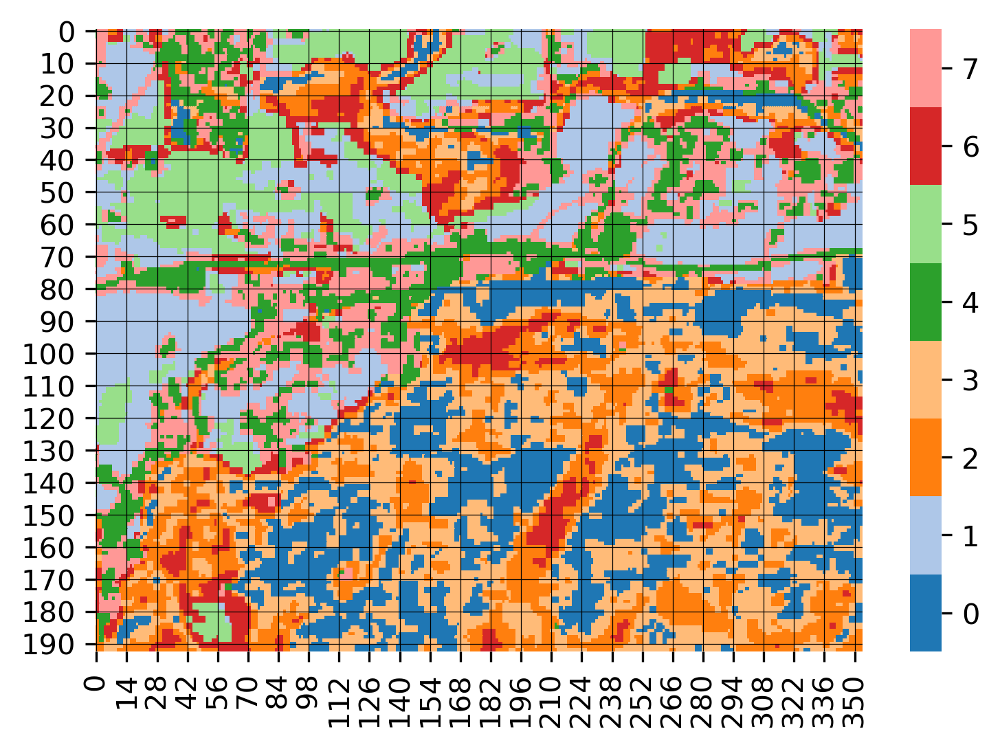

In [19]:
plt.figure()
# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(labels, cmap=cmap) 
# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)
plt.savefig(f'{figures_filepath}/clusters.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE BY CLUSTERS**

<Figure size 432x288 with 0 Axes>

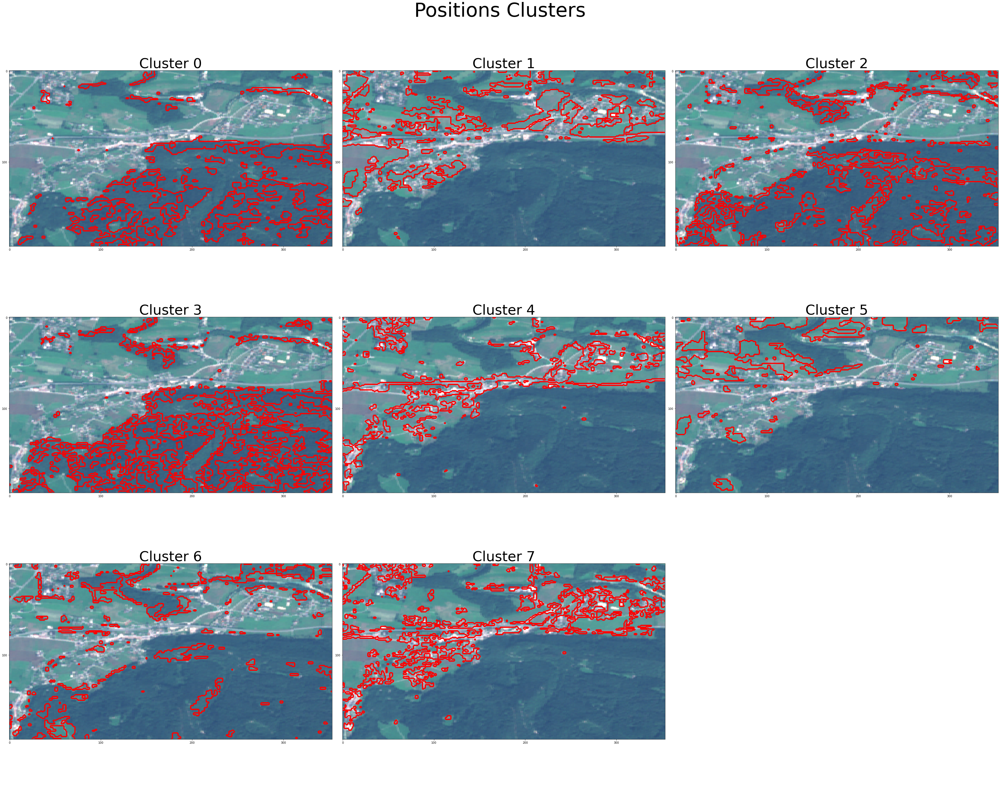

In [20]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Clusters', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    image = testing
    img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
    img = np.clip(img, 0, 1)
    img = ax.imshow(img)
    ax.contour(cluster, colors='red', linewidths=1.5)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/clusters_TCC.png', format='png', dpi=300)
plt.show()

**DIFFERENCES BETWEEN CLUSTERS**

- Function to get the positions of all pixels differenciated by their cluster

In [21]:
allClusters_pixels = []
for cluster in range(n_clusters):
    cluster = labels == cluster
    result=np.where(cluster)
    pixels = list(zip(result[0], result[1]))
    allClusters_pixels.append(pixels)
print(f'len:{len(allClusters_pixels)}')

len:8


- Get data per cluster and represent

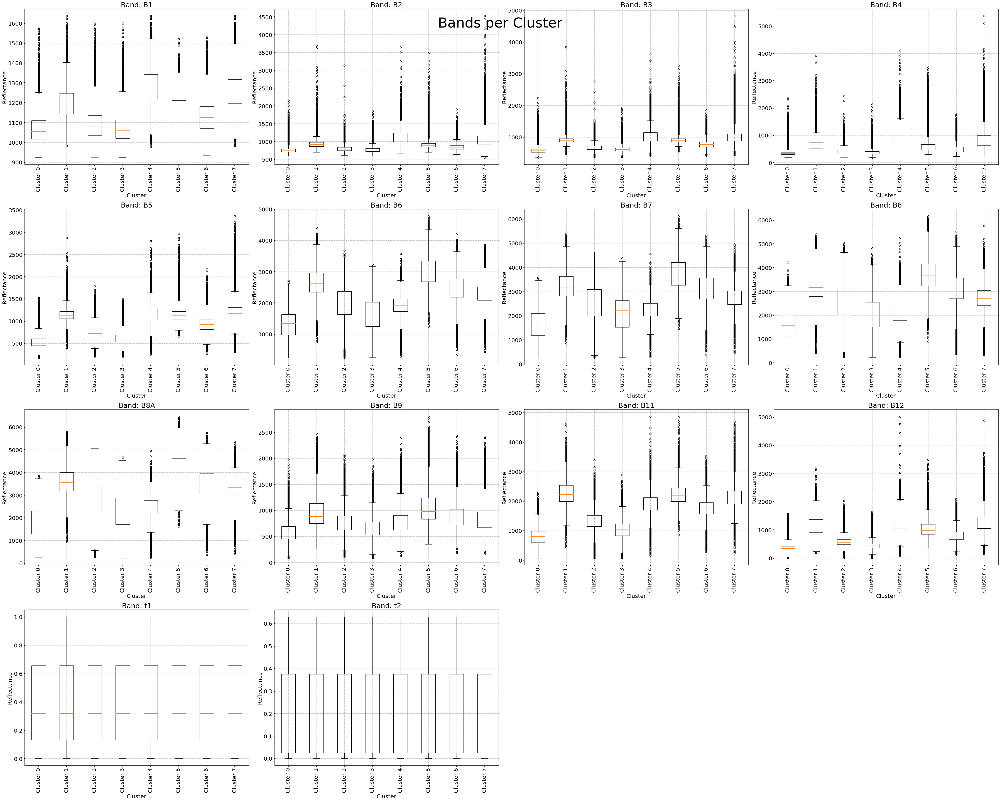

In [23]:
#Fill in number of figures:
n_figures = training.shape[1]

# Save data
data_perband = []

#Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

#Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Bands per Cluster', fontsize = 50)

##Plot random selection of pixels per band
for sp in range(n_figures):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = allClusters_pixels[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, sp, int(pixel[0]), int(pixel[1])]
                data_cluster.append(pixel)
        data.append(data_cluster)
    data = np.array(data, dtype=object)
    data_perband.append(data)
    
    # Customize band plot
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

#delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

#save
data_perband = np.array(data_perband)
plt.tight_layout()
fig.subplots_adjust(top=0.99)
plt.savefig(f'{figures_filepath}/boxplots_clusters.png', format='png', dpi=300)
plt.show()

# Re-clustering

- Study data distribution

In [24]:
data_perband.shape

(14, 8)

In [28]:
bands =[]
clusters = []
values = 
for band in range(len(bands)):
    for cluster in range(len(band)):
        clusters.append(cluster)
dataframe = pd.DataFrame({
    'Band' : bands,
    'Cluster' : clusters
})
dataframe

,Band,Cluster
0,"[[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...","[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...."
1,"[[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...","[1369.0, 1369.0, 1369.0, 1318.0, 1318.0, 1318...."
2,"[[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...","[1467.0, 1369.0, 1369.0, 1369.0, 1245.0, 1245...."
3,"[[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...","[1256.0, 1256.0, 1256.0, 1292.0, 1292.0, 1256...."
4,"[[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...","[1467.0, 1440.0, 1440.0, 1440.0, 1440.0, 1440...."
...,...,...
107,"[[0.5021517691481221, 0.5021517691481221, 0.50...","[0.5021517691481221, 0.5021517691481221, 0.502..."
108,"[[0.5021517691481221, 0.5021517691481221, 0.50...","[0.5021517691481221, 0.5021517691481221, 0.502..."
109,"[[0.5021517691481221, 0.5021517691481221, 0.50...","[0.5021517691481221, 0.5021517691481221, 0.502..."
110,"[[0.5021517691481221, 0.5021517691481221, 0.50...","[0.5021517691481221, 0.5021517691481221, 0.502..."


In [29]:
dataframe.describe

<bound method NDFrame.describe of                                                   Band  \
0    [[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...   
1    [[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...   
2    [[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...   
3    [[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...   
4    [[1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245...   
..                                                 ...   
107  [[0.5021517691481221, 0.5021517691481221, 0.50...   
108  [[0.5021517691481221, 0.5021517691481221, 0.50...   
109  [[0.5021517691481221, 0.5021517691481221, 0.50...   
110  [[0.5021517691481221, 0.5021517691481221, 0.50...   
111  [[0.5021517691481221, 0.5021517691481221, 0.50...   

                                               Cluster  
0    [1245.0, 1245.0, 1245.0, 1245.0, 1245.0, 1245....  
1    [1369.0, 1369.0, 1369.0, 1318.0, 1318.0, 1318....  
2    [1467.0, 1369.0, 1369.0, 1369.0, 1245.0, 1245....  
3    [1256.0, 1256.0, 1256.0, 1292.0, 129

In [30]:
bands =[]
clusters = []
minimums = []
maximums = []
means = []
modes = []
for band in range(len(data_perband)):
    b = data_perband[band]
    for cluster in range(len(b)):
        values = b[cluster]
        minimum = min(values)
        maximum = max(values)
        mean = sum(values)/len(values)
        mode = max(set(values), key=values.count)
        
        bands.append(band)
        clusters.append(cluster)
        minimums.append(minimum)
        maximums.append(maximum)
        means.append(mean)
        modes.append(mode)

KeyboardInterrupt: 

In [ ]:
dataframe = pd.DataFrame({
    'Band' : bands,
    'Cluster' : clusters,
    'Minimum'
})
dataframe

# Get training and testing pixels

- **Training: by representativity**

Shape: (193, 354)


<Figure size 432x288 with 0 Axes>

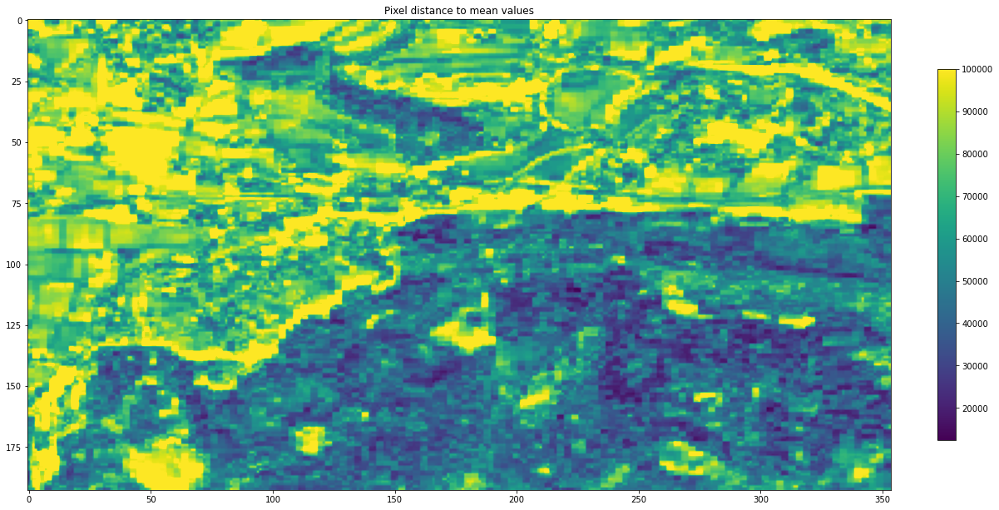

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Min difference: 12415.032313860986
Pixel 0: (110, 224)
Min difference: 12415.032313860986
Pixel 1: (110, 225)
Min difference: 12661.00261461287
Pixel 2: (111, 226)
Min difference: 12910.383287642755
Pixel 3: (159, 303)
Min difference: 13894.185133409872
Pixel 4: (111, 224)
Min difference: 13894.185133409872
Pixel 5: (111, 225)
Min difference: 13989.959381530156
Pixel 6: (85, 347)
Min difference: 14318.220847695575
Pixel 7: (85, 345)
Min difference: 14318.220847695575
Pixel 8: (85, 346)
Min difference: 14894.30299055273
Pixel 9: (110, 226)
Min difference: 15273.6695319061
Pixel 10: (110, 221)
Min difference: 15273.6695319061
Pixel 11: (110, 222)
Min difference: 15313.706407943511
Pixel 12: (159, 304)
Min difference: 15313.706407943511
Pixel 13: (159, 305)
Min difference: 15509.121445537494
Pixel 14: (16

Min difference: 20108.48685907131
Pixel 154: (127, 344)
Min difference: 20125.232689800847
Pixel 155: (85, 344)
Min difference: 20127.838516868513
Pixel 156: (167, 349)
Min difference: 20127.838516868513
Pixel 157: (167, 350)
Min difference: 20230.49152438732
Pixel 158: (155, 239)
Min difference: 20247.238328898587
Pixel 159: (131, 324)
Min difference: 20247.238328898587
Pixel 160: (131, 325)
Min difference: 20269.21144919934
Pixel 161: (159, 114)
Min difference: 20269.21144919934
Pixel 162: (159, 115)
Min difference: 20272.77329130459
Pixel 163: (145, 169)
Min difference: 20273.704306342195
Pixel 164: (123, 128)
Min difference: 20273.704306342195
Pixel 165: (123, 129)
Min difference: 20287.834005590317
Pixel 166: (161, 333)
Min difference: 20351.333253710633
Pixel 167: (140, 241)
Min difference: 20351.333253710633
Pixel 168: (140, 242)
Min difference: 20357.059757470015
Pixel 169: (160, 335)
Min difference: 20357.059757470015
Pixel 170: (160, 336)
Min difference: 20452.39039656779
Pix

Min difference: 21972.763738770576
Pixel 311: (143, 258)
Min difference: 22003.786295161553
Pixel 312: (139, 258)
Min difference: 22015.844155966275
Pixel 313: (111, 150)
Min difference: 22015.844155966275
Pixel 314: (111, 151)
Min difference: 22034.374419124164
Pixel 315: (176, 142)
Min difference: 22048.959569500068
Pixel 316: (147, 256)
Min difference: 22048.959569500068
Pixel 317: (147, 257)
Min difference: 22049.261449199344
Pixel 318: (166, 269)
Min difference: 22055.489644688045
Pixel 319: (160, 337)
Min difference: 22065.798291304585
Pixel 320: (163, 340)
Min difference: 22066.262986890848
Pixel 321: (138, 267)
Min difference: 22074.512952958743
Pixel 322: (150, 344)
Min difference: 22074.512952958743
Pixel 323: (150, 345)
Min difference: 22077.049419124145
Pixel 324: (142, 336)
Min difference: 22077.049419124145
Pixel 325: (142, 337)
Min difference: 22101.45637401136
Pixel 326: (162, 340)
Min difference: 22107.040396567747
Pixel 327: (172, 244)
Min difference: 22140.8667123572

Min difference: 23413.96351686852
Pixel 464: (171, 313)
Min difference: 23415.02200944726
Pixel 465: (163, 349)
Min difference: 23441.70847561268
Pixel 466: (147, 240)
Min difference: 23441.70847561268
Pixel 467: (147, 241)
Min difference: 23446.18494543995
Pixel 468: (153, 347)
Min difference: 23446.18494543995
Pixel 469: (153, 348)
Min difference: 23446.787389049
Pixel 470: (166, 343)
Min difference: 23446.787389049
Pixel 471: (166, 344)
Min difference: 23457.862764988808
Pixel 472: (162, 336)
Min difference: 23461.665208597828
Pixel 473: (161, 330)
Min difference: 23477.080656063816
Pixel 474: (143, 259)
Min difference: 23477.080656063816
Pixel 475: (143, 260)
Min difference: 23536.46276498882
Pixel 476: (136, 271)
Min difference: 23562.1814079435
Pixel 477: (134, 264)
Min difference: 23562.43140794349
Pixel 478: (133, 243)
Min difference: 23579.9580657407
Pixel 479: (152, 347)
Min difference: 23579.9580657407
Pixel 480: (152, 348)
Min difference: 23581.641558319447
Pixel 481: (140,

Min difference: 24456.96373877056
Pixel 616: (163, 73)
Min difference: 24462.582347793126
Pixel 617: (151, 244)
Min difference: 24462.582347793126
Pixel 618: (152, 243)
Min difference: 24462.582347793126
Pixel 619: (152, 244)
Min difference: 24462.81749816906
Pixel 620: (148, 344)
Min difference: 24462.81749816906
Pixel 621: (148, 345)
Min difference: 24463.755246191795
Pixel 622: (129, 268)
Min difference: 24465.40490418409
Pixel 623: (144, 172)
Min difference: 24479.288140928657
Pixel 624: (153, 326)
Min difference: 24479.288140928657
Pixel 625: (153, 327)
Min difference: 24502.143967996322
Pixel 626: (134, 272)
Min difference: 24502.143967996322
Pixel 627: (134, 273)
Min difference: 24504.960321379804
Pixel 628: (152, 328)
Min difference: 24528.962952958733
Pixel 629: (183, 352)
Min difference: 24528.962952958733
Pixel 630: (183, 353)
Min difference: 24544.50919356026
Pixel 631: (129, 154)
Min difference: 24573.54099440966
Pixel 632: (143, 169)
Min difference: 24586.4150206279
Pixel

Min difference: 25456.892276267026
Pixel 771: (128, 318)
Min difference: 25458.715208597838
Pixel 772: (155, 242)
Min difference: 25468.29302814674
Pixel 773: (93, 286)
Min difference: 25468.29302814674
Pixel 774: (93, 287)
Min difference: 25476.790806439756
Pixel 775: (41, 173)
Min difference: 25476.790806439756
Pixel 776: (41, 174)
Min difference: 25481.534415462316
Pixel 777: (149, 163)
Min difference: 25481.534415462316
Pixel 778: (149, 164)
Min difference: 25482.495881627707
Pixel 779: (162, 347)
Min difference: 25482.495881627707
Pixel 780: (162, 348)
Min difference: 25488.968625988608
Pixel 781: (156, 352)
Min difference: 25493.931219973587
Pixel 782: (129, 346)
Min difference: 25493.931219973587
Pixel 783: (129, 347)
Min difference: 25500.837952958733
Pixel 784: (128, 326)
Min difference: 25515.54719741719
Pixel 785: (16, 94)
Min difference: 25522.92235145498
Pixel 786: (128, 314)
Min difference: 25523.933287642772
Pixel 787: (148, 154)
Min difference: 25523.933287642772
Pixel 

Min difference: 40887.50470514428
Pixel 16: (52, 140)
Min difference: 40986.6469050606
Pixel 17: (97, 41)
Min difference: 40986.6469050606
Pixel 18: (97, 42)
Min difference: 41542.62933918862
Pixel 19: (51, 139)
Min difference: 41542.62933918862
Pixel 20: (51, 140)
Min difference: 41829.587306566325
Pixel 21: (61, 293)
Min difference: 42027.75731911329
Pixel 22: (97, 40)
Min difference: 42102.1372856545
Pixel 23: (96, 41)
Min difference: 42102.1372856545
Pixel 24: (96, 42)
Min difference: 42161.514742785475
Pixel 25: (61, 291)
Min difference: 42161.514742785475
Pixel 26: (61, 292)
Min difference: 42825.90746549562
Pixel 27: (51, 141)
Min difference: 43078.45556252609
Pixel 28: (96, 40)
Min difference: 43238.07789627775
Pixel 29: (27, 220)
Min difference: 43238.07789627775
Pixel 30: (27, 221)
Min difference: 43311.25501882057
Pixel 31: (64, 216)
Min difference: 43439.69751150146
Pixel 32: (95, 40)
Min difference: 43561.310016729454
Pixel 33: (27, 219)
Min difference: 43751.31043496445
P

Min difference: 51976.121392722685
Pixel 176: (57, 207)
Min difference: 51977.684127979934
Pixel 177: (37, 255)
Min difference: 51983.428168130464
Pixel 178: (49, 96)
Min difference: 51983.428168130464
Pixel 179: (49, 97)
Min difference: 52085.376725219576
Pixel 180: (41, 249)
Min difference: 52104.509305729815
Pixel 181: (49, 99)
Min difference: 52104.509305729815
Pixel 182: (49, 100)
Min difference: 52107.902655792546
Pixel 183: (53, 280)
Min difference: 52107.902655792546
Pixel 184: (53, 281)
Min difference: 52116.36919698872
Pixel 185: (42, 249)
Min difference: 52116.36919698872
Pixel 186: (42, 250)
Min difference: 52116.98713927226
Pixel 187: (95, 10)
Min difference: 52116.98713927226
Pixel 188: (95, 11)
Min difference: 52121.53837306561
Pixel 189: (112, 74)
Min difference: 52121.53837306561
Pixel 190: (112, 75)
Min difference: 52123.06702216647
Pixel 191: (94, 10)
Min difference: 52123.06702216647
Pixel 192: (94, 11)
Min difference: 52220.93130489332
Pixel 193: (52, 142)
Min diff

Min difference: 54767.38927227104
Pixel 340: (95, 18)
Min difference: 54794.069531576715
Pixel 341: (56, 206)
Min difference: 54794.069531576715
Pixel 342: (56, 207)
Min difference: 54806.09190715179
Pixel 343: (61, 199)
Min difference: 54806.09190715179
Pixel 344: (61, 200)
Min difference: 54816.82047260558
Pixel 345: (62, 193)
Min difference: 54816.82047260558
Pixel 346: (62, 194)
Min difference: 54818.1962567963
Pixel 347: (115, 66)
Min difference: 54834.507423672076
Pixel 348: (46, 219)
Min difference: 54834.507423672076
Pixel 349: (46, 220)
Min difference: 54876.82946465913
Pixel 350: (23, 0)
Min difference: 54882.320263488094
Pixel 351: (38, 255)
Min difference: 54892.078105395216
Pixel 352: (57, 214)
Min difference: 54925.934859891226
Pixel 353: (52, 212)
Min difference: 54925.934859891226
Pixel 354: (52, 213)
Min difference: 54931.688101212894
Pixel 355: (68, 288)
Min difference: 54931.688101212894
Pixel 356: (68, 289)
Min difference: 54971.05970305313
Pixel 357: (107, 120)
Min

Min difference: 56632.41603931407
Pixel 504: (62, 278)
Min difference: 56634.26986616481
Pixel 505: (58, 328)
Min difference: 56634.26986616481
Pixel 506: (58, 329)
Min difference: 56646.13728565456
Pixel 507: (39, 244)
Min difference: 56646.13728565456
Pixel 508: (39, 245)
Min difference: 56653.11428272687
Pixel 509: (44, 123)
Min difference: 56664.36877875361
Pixel 510: (47, 98)
Min difference: 56667.63331242155
Pixel 511: (63, 74)
Min difference: 56667.63331242155
Pixel 512: (63, 75)
Min difference: 56684.89094521119
Pixel 513: (105, 43)
Min difference: 56684.89094521119
Pixel 514: (105, 44)
Min difference: 56706.91499372647
Pixel 515: (4, 197)
Min difference: 56706.91499372647
Pixel 516: (4, 198)
Min difference: 56716.97542869091
Pixel 517: (4, 202)
Min difference: 56752.730761187784
Pixel 518: (63, 217)
Min difference: 56845.910393140955
Pixel 519: (54, 123)
Min difference: 56845.910393140955
Pixel 520: (54, 124)
Min difference: 56852.68036386453
Pixel 521: (60, 94)
Min difference

Min difference: 58299.9490798829
Pixel 669: (94, 17)
Min difference: 58299.9490798829
Pixel 670: (94, 18)
Min difference: 58311.11574654953
Pixel 671: (62, 196)
Min difference: 58311.11574654953
Pixel 672: (62, 197)
Min difference: 58315.17680886661
Pixel 673: (15, 195)
Min difference: 58318.29558762028
Pixel 674: (40, 247)
Min difference: 58318.29558762028
Pixel 675: (40, 248)
Min difference: 58326.73828941871
Pixel 676: (23, 232)
Min difference: 58326.73828941871
Pixel 677: (23, 233)
Min difference: 58328.7249058971
Pixel 678: (49, 102)
Min difference: 58328.7249058971
Pixel 679: (49, 103)
Min difference: 58358.44343370974
Pixel 680: (73, 26)
Min difference: 58380.34473023842
Pixel 681: (34, 305)
Min difference: 58380.34473023842
Pixel 682: (34, 306)
Min difference: 58417.237871183585
Pixel 683: (47, 221)
Min difference: 58418.24121706398
Pixel 684: (67, 288)
Min difference: 58418.24121706398
Pixel 685: (67, 289)
Min difference: 58419.33176495191
Pixel 686: (59, 342)
Min difference: 

Min difference: 22178.63455476754
Pixel 8: (107, 242)
Min difference: 22406.91430260047
Pixel 9: (108, 242)
Min difference: 22614.44897557132
Pixel 10: (106, 169)
Min difference: 22614.44897557132
Pixel 11: (106, 170)
Min difference: 22659.65878644602
Pixel 12: (113, 242)
Min difference: 22659.65878644602
Pixel 13: (113, 243)
Min difference: 22916.22360126083
Pixel 14: (109, 235)
Min difference: 23247.739755713137
Pixel 15: (98, 270)
Min difference: 23320.083530338863
Pixel 16: (107, 169)
Min difference: 23320.083530338863
Pixel 17: (107, 170)
Min difference: 23356.293538219074
Pixel 18: (113, 240)
Min difference: 23356.293538219074
Pixel 19: (114, 239)
Min difference: 23610.405634357758
Pixel 20: (114, 240)
Min difference: 23610.405634357758
Pixel 21: (115, 239)
Min difference: 23868.227738376652
Pixel 22: (109, 233)
Min difference: 23868.227738376652
Pixel 23: (109, 234)
Min difference: 24037.418242710806
Pixel 24: (109, 249)
Min difference: 24037.418242710806
Pixel 25: (109, 250)
Mi

Min difference: 30730.772655634388
Pixel 161: (108, 247)
Min difference: 30790.217691095353
Pixel 162: (136, 42)
Min difference: 30790.217691095353
Pixel 163: (136, 43)
Min difference: 30792.372537431056
Pixel 164: (97, 265)
Min difference: 30792.372537431056
Pixel 165: (97, 266)
Min difference: 30805.561071710017
Pixel 166: (97, 285)
Min difference: 30808.46631205674
Pixel 167: (10, 324)
Min difference: 30821.01024428685
Pixel 168: (37, 136)
Min difference: 30821.01024428685
Pixel 169: (37, 137)
Min difference: 30832.67080378252
Pixel 170: (92, 163)
Min difference: 30838.893026004724
Pixel 171: (98, 197)
Min difference: 30838.893026004724
Pixel 172: (98, 198)
Min difference: 30843.24054373526
Pixel 173: (119, 230)
Min difference: 30843.24054373526
Pixel 174: (119, 231)
Min difference: 30862.692277383776
Pixel 175: (137, 45)
Min difference: 30862.692277383776
Pixel 176: (137, 46)
Min difference: 30922.49468085106
Pixel 177: (121, 337)
Min difference: 30922.49468085106
Pixel 178: (121, 

Min difference: 33520.5642237983
Pixel 326: (120, 332)
Min difference: 33544.78467297087
Pixel 327: (125, 229)
Min difference: 33544.78467297087
Pixel 328: (125, 230)
Min difference: 33612.69996059889
Pixel 329: (124, 235)
Min difference: 33612.69996059889
Pixel 330: (124, 236)
Min difference: 33629.61997635934
Pixel 331: (98, 267)
Min difference: 33632.77068557922
Pixel 332: (119, 330)
Min difference: 33660.33293932231
Pixel 333: (142, 31)
Min difference: 33667.33096926716
Pixel 334: (180, 205)
Min difference: 33667.33096926716
Pixel 335: (180, 206)
Min difference: 33667.53565799843
Pixel 336: (138, 45)
Min difference: 33667.53565799843
Pixel 337: (138, 46)
Min difference: 33688.02836879434
Pixel 338: (96, 246)
Min difference: 33688.02836879434
Pixel 339: (96, 247)
Min difference: 33691.435579196186
Pixel 340: (104, 233)
Min difference: 33723.152285263976
Pixel 341: (26, 124)
Min difference: 33741.23010244288
Pixel 342: (147, 43)
Min difference: 33755.9866036249
Pixel 343: (94, 234)
M

Min difference: 35595.01713947997
Pixel 488: (146, 140)
Min difference: 35597.042159180506
Pixel 489: (146, 298)
Min difference: 35598.160953506725
Pixel 490: (168, 205)
Min difference: 35598.160953506725
Pixel 491: (168, 206)
Min difference: 35631.26319936963
Pixel 492: (116, 220)
Min difference: 35632.47951142631
Pixel 493: (13, 118)
Min difference: 35674.8248620962
Pixel 494: (145, 299)
Min difference: 35674.8248620962
Pixel 495: (145, 300)
Min difference: 35679.35204885731
Pixel 496: (109, 251)
Min difference: 35692.58234830579
Pixel 497: (99, 283)
Min difference: 35692.58234830579
Pixel 498: (99, 284)
Min difference: 35715.59495665881
Pixel 499: (167, 196)
Min difference: 35715.59495665881
Pixel 500: (167, 197)
Min difference: 35716.11465721039
Pixel 501: (33, 136)
Min difference: 35718.74921197795
Pixel 502: (176, 199)
Min difference: 35718.74921197795
Pixel 503: (176, 200)
Min difference: 35726.883963750966
Pixel 504: (166, 198)
Min difference: 35741.765169424776
Pixel 505: (95,

Min difference: 36795.41706067773
Pixel 651: (101, 290)
Min difference: 36802.933412135535
Pixel 652: (118, 318)
Min difference: 36826.16824271083
Pixel 653: (146, 299)
Min difference: 36826.16824271083
Pixel 654: (146, 300)
Min difference: 36828.71237194643
Pixel 655: (117, 321)
Min difference: 36834.39302600475
Pixel 656: (109, 238)
Min difference: 36840.63888888892
Pixel 657: (40, 147)
Min difference: 36847.63869188339
Pixel 658: (172, 210)
Min difference: 36849.86091410559
Pixel 659: (107, 172)
Min difference: 36849.86091410559
Pixel 660: (107, 173)
Min difference: 36855.69011032308
Pixel 661: (28, 318)
Min difference: 36855.69011032308
Pixel 662: (28, 319)
Min difference: 36862.52364066204
Pixel 663: (110, 245)
Min difference: 36863.80200945631
Pixel 664: (156, 295)
Min difference: 36863.80200945631
Pixel 665: (156, 296)
Min difference: 36879.61327817185
Pixel 666: (95, 246)
Min difference: 36879.61327817185
Pixel 667: (95, 247)
Min difference: 36882.127068557995
Pixel 668: (176, 

Min difference: 17832.958483783535
Pixel 13: (167, 308)
Min difference: 17871.700705029616
Pixel 14: (131, 296)
Min difference: 17871.700705029616
Pixel 15: (131, 297)
Min difference: 18055.74756058272
Pixel 16: (140, 286)
Min difference: 18275.500114942603
Pixel 17: (88, 159)
Min difference: 18275.500114942603
Pixel 18: (89, 158)
Min difference: 18412.87216706929
Pixel 19: (132, 298)
Min difference: 18495.818868877643
Pixel 20: (128, 302)
Min difference: 18551.672152426952
Pixel 21: (127, 302)
Min difference: 18576.017199648537
Pixel 22: (140, 284)
Min difference: 18576.017199648537
Pixel 23: (140, 285)
Min difference: 18617.046337945634
Pixel 24: (132, 237)
Min difference: 18630.186465334184
Pixel 25: (129, 292)
Min difference: 18635.09919686651
Pixel 26: (138, 317)
Min difference: 18635.09919686651
Pixel 27: (138, 318)
Min difference: 18643.84632330329
Pixel 28: (139, 284)
Min difference: 18643.84632330329
Pixel 29: (139, 285)
Min difference: 18711.420230617143
Pixel 30: (130, 290)


Min difference: 21831.29380408531
Pixel 174: (93, 254)
Min difference: 21915.63591258508
Pixel 175: (105, 334)
Min difference: 21930.012074822436
Pixel 176: (89, 163)
Min difference: 21941.308509407696
Pixel 177: (134, 307)
Min difference: 21947.05995534078
Pixel 178: (125, 294)
Min difference: 21947.05995534078
Pixel 179: (125, 295)
Min difference: 21948.264069844037
Pixel 180: (115, 204)
Min difference: 21959.67867852703
Pixel 181: (87, 166)
Min difference: 21968.04883739666
Pixel 182: (87, 164)
Min difference: 21968.04883739666
Pixel 183: (87, 165)
Min difference: 21974.982643678137
Pixel 184: (130, 292)
Min difference: 22010.983668643363
Pixel 185: (171, 276)
Min difference: 22010.983668643363
Pixel 186: (171, 277)
Min difference: 22020.795148253826
Pixel 187: (112, 232)
Min difference: 22029.894946189408
Pixel 188: (134, 134)
Min difference: 22029.894946189408
Pixel 189: (134, 135)
Min difference: 22037.708988212966
Pixel 190: (119, 223)
Min difference: 22087.210332381568
Pixel 19

Min difference: 23755.817917124223
Pixel 335: (105, 340)
Min difference: 23766.996198111185
Pixel 336: (108, 159)
Min difference: 23769.759494106424
Pixel 337: (103, 322)
Min difference: 23787.142318617734
Pixel 338: (114, 226)
Min difference: 23803.94143568351
Pixel 339: (142, 129)
Min difference: 23807.086091953992
Pixel 340: (114, 205)
Min difference: 23807.086091953992
Pixel 341: (114, 206)
Min difference: 23818.868506479223
Pixel 342: (156, 257)
Min difference: 23832.23368694631
Pixel 343: (148, 308)
Min difference: 23832.23368694631
Pixel 344: (148, 309)
Min difference: 23838.707220879987
Pixel 345: (156, 255)
Min difference: 23838.707220879987
Pixel 346: (156, 256)
Min difference: 23842.409834541337
Pixel 347: (113, 196)
Min difference: 23842.409834541337
Pixel 348: (113, 197)
Min difference: 23862.593376528275
Pixel 349: (132, 293)
Min difference: 23862.593376528275
Pixel 350: (132, 294)
Min difference: 23887.69112453334
Pixel 351: (104, 242)
Min difference: 23917.970051248245


Min difference: 24847.92679332316
Pixel 491: (115, 227)
Min difference: 24847.92679332316
Pixel 492: (115, 228)
Min difference: 24853.357059081987
Pixel 493: (142, 34)
Min difference: 24857.55260780445
Pixel 494: (136, 131)
Min difference: 24857.55260780445
Pixel 495: (136, 132)
Min difference: 24858.029436269215
Pixel 496: (102, 316)
Min difference: 24858.029436269215
Pixel 497: (102, 317)
Min difference: 24867.959142689768
Pixel 498: (133, 305)
Min difference: 24867.959142689768
Pixel 499: (133, 306)
Min difference: 24874.937032725633
Pixel 500: (138, 301)
Min difference: 24908.69528735632
Pixel 501: (100, 303)
Min difference: 24911.72640237204
Pixel 502: (91, 261)
Min difference: 24926.912506772023
Pixel 503: (163, 315)
Min difference: 24937.236186397335
Pixel 504: (137, 134)
Min difference: 24937.236186397335
Pixel 505: (137, 135)
Min difference: 24942.904097664614
Pixel 506: (186, 311)
Min difference: 24978.47989823557
Pixel 507: (117, 204)
Min difference: 24998.511379310323
Pixel

Min difference: 26045.597988871763
Pixel 650: (166, 324)
Min difference: 26047.832935793296
Pixel 651: (107, 160)
Min difference: 26047.832935793296
Pixel 652: (107, 161)
Min difference: 26069.32909217372
Pixel 653: (31, 131)
Min difference: 26069.32909217372
Pixel 654: (31, 132)
Min difference: 26078.816526099967
Pixel 655: (164, 310)
Min difference: 26078.816526099967
Pixel 656: (164, 311)
Min difference: 26079.41738560662
Pixel 657: (154, 70)
Min difference: 26082.657813163554
Pixel 658: (142, 127)
Min difference: 26082.657813163554
Pixel 659: (142, 128)
Min difference: 26091.93447031256
Pixel 660: (169, 276)
Min difference: 26091.93447031256
Pixel 661: (169, 277)
Min difference: 26112.480201332517
Pixel 662: (181, 134)
Min difference: 26112.480201332517
Pixel 663: (181, 135)
Min difference: 26130.18984332683
Pixel 664: (175, 245)
Min difference: 26130.18984332683
Pixel 665: (175, 246)
Min difference: 26144.38003733797
Pixel 666: (92, 265)
Min difference: 26144.38003733797
Pixel 667

Min difference: 33223.63989983307
Pixel 5: (6, 62)
Min difference: 33223.63989983307
Pixel 6: (6, 63)
Min difference: 33963.92871452418
Pixel 7: (28, 62)
Min difference: 33963.95642737899
Pixel 8: (6, 61)
Min difference: 34406.37946577631
Pixel 9: (9, 36)
Min difference: 34919.0465776294
Pixel 10: (4, 74)
Min difference: 34919.0465776294
Pixel 11: (4, 75)
Min difference: 35182.880300500794
Pixel 12: (67, 183)
Min difference: 35591.58714524204
Pixel 13: (63, 245)
Min difference: 35591.58714524204
Pixel 14: (63, 246)
Min difference: 36139.03555926542
Pixel 15: (39, 293)
Min difference: 36139.03555926542
Pixel 16: (39, 294)
Min difference: 36391.4853088481
Pixel 17: (35, 265)
Min difference: 36391.4853088481
Pixel 18: (35, 266)
Min difference: 36852.25592654421
Pixel 19: (67, 181)
Min difference: 36852.25592654421
Pixel 20: (67, 182)
Min difference: 36931.58814691153
Pixel 21: (124, 75)
Min difference: 37007.63589315521
Pixel 22: (49, 263)
Min difference: 37064.458931552595
Pixel 23: (27,

Min difference: 43580.82020033391
Pixel 163: (55, 259)
Min difference: 43602.62587646079
Pixel 164: (60, 236)
Min difference: 43602.62587646079
Pixel 165: (60, 237)
Min difference: 43611.18514190322
Pixel 166: (6, 64)
Min difference: 43618.29999999999
Pixel 167: (73, 115)
Min difference: 43627.78614357262
Pixel 168: (27, 59)
Min difference: 43813.55008347244
Pixel 169: (72, 142)
Min difference: 43893.155425709556
Pixel 170: (45, 346)
Min difference: 43912.09232053421
Pixel 171: (113, 36)
Min difference: 43986.09165275461
Pixel 172: (31, 289)
Min difference: 43997.3694490818
Pixel 173: (59, 245)
Min difference: 43997.3694490818
Pixel 174: (59, 246)
Min difference: 44035.160767946596
Pixel 175: (97, 132)
Min difference: 44043.18881469121
Pixel 176: (67, 152)
Min difference: 44056.90901502501
Pixel 177: (65, 172)
Min difference: 44056.90901502501
Pixel 178: (65, 173)
Min difference: 44058.651585976666
Pixel 179: (56, 258)
Min difference: 44058.651585976666
Pixel 180: (56, 259)
Min differe

Min difference: 47196.80884808015
Pixel 326: (84, 97)
Min difference: 47196.80884808015
Pixel 327: (84, 98)
Min difference: 47211.29799666116
Pixel 328: (30, 272)
Min difference: 47211.29799666116
Pixel 329: (30, 273)
Min difference: 47256.18113522536
Pixel 330: (114, 30)
Min difference: 47325.87295492481
Pixel 331: (71, 152)
Min difference: 47351.562437395696
Pixel 332: (0, 43)
Min difference: 47352.9263772955
Pixel 333: (125, 76)
Min difference: 47352.9263772955
Pixel 334: (125, 77)
Min difference: 47374.839565943184
Pixel 335: (72, 139)
Min difference: 47450.38180300499
Pixel 336: (76, 26)
Min difference: 47467.3373956594
Pixel 337: (98, 92)
Min difference: 47481.284974958224
Pixel 338: (75, 128)
Min difference: 47481.284974958224
Pixel 339: (75, 129)
Min difference: 47496.03188647749
Pixel 340: (75, 113)
Min difference: 47496.03188647749
Pixel 341: (75, 114)
Min difference: 47526.35909849746
Pixel 342: (48, 264)
Min difference: 47526.35909849746
Pixel 343: (48, 265)
Min difference:

Min difference: 49812.3674457429
Pixel 481: (65, 178)
Min difference: 49812.3674457429
Pixel 482: (65, 179)
Min difference: 49827.81519198659
Pixel 483: (69, 153)
Min difference: 49827.81519198659
Pixel 484: (69, 154)
Min difference: 49841.60150250414
Pixel 485: (47, 264)
Min difference: 49862.86961602674
Pixel 486: (139, 7)
Min difference: 49895.25726210348
Pixel 487: (53, 261)
Min difference: 49895.25726210348
Pixel 488: (53, 262)
Min difference: 49904.86794657764
Pixel 489: (121, 49)
Min difference: 49904.86794657764
Pixel 490: (121, 50)
Min difference: 49919.56277128545
Pixel 491: (98, 135)
Min difference: 49937.39382303845
Pixel 492: (3, 74)
Min difference: 49937.39382303845
Pixel 493: (3, 75)
Min difference: 49939.85225375624
Pixel 494: (84, 96)
Min difference: 49959.64257095156
Pixel 495: (33, 268)
Min difference: 49959.64257095156
Pixel 496: (33, 269)
Min difference: 49996.08497495827
Pixel 497: (32, 62)
Min difference: 50006.9614357262
Pixel 498: (29, 65)
Min difference: 50022

Min difference: 51805.00818030053
Pixel 634: (57, 321)
Min difference: 51805.98013355592
Pixel 635: (74, 32)
Min difference: 51816.946744574234
Pixel 636: (70, 155)
Min difference: 51824.846577629345
Pixel 637: (96, 138)
Min difference: 51824.99215358934
Pixel 638: (23, 50)
Min difference: 51861.57545909843
Pixel 639: (95, 142)
Min difference: 51861.57545909843
Pixel 640: (95, 143)
Min difference: 51862.02320534222
Pixel 641: (94, 121)
Min difference: 51862.02320534222
Pixel 642: (94, 122)
Min difference: 51865.24924874789
Pixel 643: (123, 70)
Min difference: 51865.24924874789
Pixel 644: (123, 71)
Min difference: 51865.496327212066
Pixel 645: (70, 164)
Min difference: 51900.58981636059
Pixel 646: (72, 106)
Min difference: 51922.15843071783
Pixel 647: (113, 34)
Min difference: 51922.15843071783
Pixel 648: (113, 35)
Min difference: 51928.38814691157
Pixel 649: (21, 348)
Min difference: 51933.58647746239
Pixel 650: (1, 37)
Min difference: 51933.58647746239
Pixel 651: (1, 38)
Min differenc

Min difference: 53851.519031719494
Pixel 799: (75, 27)
Pixel Locations: [(64, 247), (7, 62), (7, 63), (63, 244), (63, 247), (6, 62), (6, 63), (28, 62), (6, 61), (9, 36), (4, 74), (4, 75), (67, 183), (63, 245), (63, 246), (39, 293), (39, 294), (35, 265), (35, 266), (67, 181), (67, 182), (124, 75), (49, 263), (27, 60), (27, 61), (67, 180), (44, 267), (0, 61), (6, 70), (6, 57), (98, 136), (98, 137), (39, 268), (39, 269), (1, 61), (126, 81), (24, 54), (24, 55), (32, 259), (32, 260), (67, 91), (101, 144), (29, 62), (70, 152), (33, 53), (31, 287), (31, 288), (64, 245), (64, 246), (68, 89), (68, 90), (42, 332), (42, 333), (6, 55), (6, 56), (22, 345), (43, 268), (43, 269), (71, 139), (43, 334), (70, 229), (70, 230), (7, 64), (65, 174), (40, 293), (40, 294), (122, 73), (122, 74), (25, 54), (25, 55), (120, 87), (64, 174), (71, 140), (67, 170), (8, 36), (76, 128), (76, 129), (56, 322), (56, 323), (39, 295), (66, 170), (68, 153), (68, 154), (7, 61), (123, 75), (47, 265), (47, 266), (112, 34), (112

Min difference: 49802.47538434957
Pixel 23: (6, 191)
Min difference: 49815.69994817757
Pixel 24: (62, 115)
Min difference: 49864.50803247535
Pixel 25: (16, 155)
Min difference: 50143.58075660736
Pixel 26: (44, 130)
Min difference: 50143.58075660736
Pixel 27: (44, 131)
Min difference: 50212.31749870443
Pixel 28: (50, 144)
Min difference: 50221.95491449296
Pixel 29: (21, 201)
Min difference: 50228.67662808775
Pixel 30: (57, 117)
Min difference: 50228.67662808775
Pixel 31: (57, 118)
Min difference: 50242.561409569855
Pixel 32: (20, 201)
Min difference: 50409.6106408706
Pixel 33: (16, 156)
Min difference: 50409.6106408706
Pixel 34: (16, 157)
Min difference: 50472.024011055415
Pixel 35: (16, 153)
Min difference: 50472.024011055415
Pixel 36: (16, 154)
Min difference: 50666.044394541386
Pixel 37: (58, 117)
Min difference: 50666.044394541386
Pixel 38: (58, 118)
Min difference: 50785.3221627224
Pixel 39: (61, 114)
Min difference: 50785.3221627224
Pixel 40: (61, 115)
Min difference: 50845.123337

Min difference: 56749.579720158945
Pixel 184: (52, 101)
Min difference: 56757.67490067378
Pixel 185: (42, 38)
Min difference: 56757.67490067378
Pixel 186: (42, 39)
Min difference: 56953.62273276903
Pixel 187: (36, 90)
Min difference: 56953.62273276903
Pixel 188: (36, 91)
Min difference: 57003.928139575
Pixel 189: (49, 145)
Min difference: 57003.928139575
Pixel 190: (49, 146)
Min difference: 57143.761098635325
Pixel 191: (35, 90)
Min difference: 57144.761098635325
Pixel 192: (50, 139)
Min difference: 57144.761098635325
Pixel 193: (50, 140)
Min difference: 57187.7222318189
Pixel 194: (49, 147)
Min difference: 57256.09483503197
Pixel 195: (51, 99)
Min difference: 57256.09483503197
Pixel 196: (51, 100)
Min difference: 57261.384522370005
Pixel 197: (60, 120)
Min difference: 57261.384522370005
Pixel 198: (60, 121)
Min difference: 57272.01865607183
Pixel 199: (48, 144)
Min difference: 57315.72568664703
Pixel 200: (17, 149)
Min difference: 57349.66954569008
Pixel 201: (48, 142)
Min difference:

Min difference: 61119.391086543415
Pixel 345: (7, 234)
Min difference: 61125.49784073244
Pixel 346: (62, 12)
Min difference: 61125.49784073244
Pixel 347: (62, 13)
Min difference: 61287.65175332523
Pixel 348: (15, 198)
Min difference: 61321.671100362786
Pixel 349: (125, 0)
Min difference: 61325.15650371391
Pixel 350: (5, 123)
Min difference: 61325.15650371391
Pixel 351: (5, 124)
Min difference: 61359.80704784933
Pixel 352: (3, 252)
Min difference: 61359.80704784933
Pixel 353: (3, 253)
Min difference: 61408.762998790786
Pixel 354: (9, 190)
Min difference: 61408.762998790786
Pixel 355: (9, 191)
Min difference: 61417.84505095867
Pixel 356: (7, 201)
Min difference: 61458.28381413029
Pixel 357: (33, 87)
Min difference: 61475.29279668337
Pixel 358: (61, 126)
Min difference: 61475.29279668337
Pixel 359: (61, 127)
Min difference: 61480.887372603174
Pixel 360: (17, 173)
Min difference: 61494.00518224215
Pixel 361: (20, 185)
Min difference: 61517.76921748143
Pixel 362: (53, 30)
Min difference: 61

Min difference: 64921.77958196579
Pixel 505: (59, 116)
Min difference: 64924.9991362929
Pixel 506: (3, 175)
Min difference: 64924.9991362929
Pixel 507: (3, 176)
Min difference: 64942.85697011571
Pixel 508: (21, 185)
Min difference: 64957.18517878739
Pixel 509: (35, 87)
Min difference: 64957.18517878739
Pixel 510: (35, 88)
Min difference: 64975.68060114009
Pixel 511: (132, 73)
Min difference: 64975.68060114009
Pixel 512: (132, 74)
Min difference: 64977.02539298676
Pixel 513: (1, 82)
Min difference: 65037.61979616519
Pixel 514: (61, 15)
Min difference: 65037.61979616519
Pixel 515: (61, 16)
Min difference: 65097.716531352635
Pixel 516: (123, 0)
Min difference: 65126.6436344792
Pixel 517: (49, 80)
Min difference: 65137.58542062531
Pixel 518: (54, 147)
Min difference: 65265.724822940014
Pixel 519: (19, 189)
Min difference: 65281.18258766625
Pixel 520: (52, 99)
Min difference: 65281.18258766625
Pixel 521: (52, 100)
Min difference: 65288.40024183798
Pixel 522: (54, 145)
Min difference: 65288.

Min difference: 67806.81136638453
Pixel 666: (54, 115)
Min difference: 67813.02176541719
Pixel 667: (5, 193)
Min difference: 67813.02176541719
Pixel 668: (5, 194)
Min difference: 67852.067196407
Pixel 669: (61, 17)
Min difference: 67901.72223181892
Pixel 670: (3, 169)
Min difference: 67901.72223181892
Pixel 671: (3, 170)
Min difference: 68005.86716185868
Pixel 672: (7, 238)
Min difference: 68017.83313180166
Pixel 673: (19, 144)
Min difference: 68017.83313180166
Pixel 674: (19, 145)
Min difference: 68143.30972534113
Pixel 675: (59, 114)
Min difference: 68143.30972534113
Pixel 676: (59, 115)
Min difference: 68149.75816203142
Pixel 677: (9, 204)
Min difference: 68190.13940231467
Pixel 678: (14, 272)
Min difference: 68196.80549317671
Pixel 679: (56, 28)
Min difference: 68196.80549317671
Pixel 680: (56, 29)
Min difference: 68208.63862497837
Pixel 681: (55, 24)
Min difference: 68211.6011400932
Pixel 682: (3, 138)
Min difference: 68211.6011400932
Pixel 683: (3, 139)
Min difference: 68230.1338

Min difference: 36261.81729853306
Pixel 5: (27, 262)
Min difference: 36730.76262145172
Pixel 6: (16, 236)
Min difference: 36730.76262145172
Pixel 7: (16, 237)
Min difference: 36809.36883215852
Pixel 8: (102, 184)
Min difference: 36905.062107068035
Pixel 9: (102, 185)
Min difference: 36905.062107068035
Pixel 10: (102, 186)
Min difference: 37233.44084587542
Pixel 11: (103, 185)
Min difference: 37233.44084587542
Pixel 12: (103, 186)
Min difference: 37391.09830443897
Pixel 13: (102, 188)
Min difference: 37391.09830443897
Pixel 14: (102, 189)
Min difference: 37840.936178319665
Pixel 15: (103, 184)
Min difference: 38246.796342160465
Pixel 16: (49, 191)
Min difference: 38246.796342160465
Pixel 17: (49, 192)
Min difference: 38328.1146885121
Pixel 18: (102, 182)
Min difference: 38328.1146885121
Pixel 19: (102, 183)
Min difference: 38927.45589636122
Pixel 20: (27, 260)
Min difference: 38927.45589636122
Pixel 21: (27, 261)
Min difference: 38956.698037721464
Pixel 22: (36, 319)
Min difference: 391

Min difference: 47269.65879215089
Pixel 170: (103, 178)
Min difference: 47269.65879215089
Pixel 171: (103, 179)
Min difference: 47273.94646599352
Pixel 172: (35, 124)
Min difference: 47273.94646599352
Pixel 173: (35, 125)
Min difference: 47401.28310154316
Pixel 174: (6, 263)
Min difference: 47413.76624118873
Pixel 175: (101, 182)
Min difference: 47413.76624118873
Pixel 176: (101, 183)
Min difference: 47420.88835968755
Pixel 177: (26, 271)
Min difference: 47464.86035435321
Pixel 178: (5, 264)
Min difference: 47464.86035435321
Pixel 179: (5, 265)
Min difference: 47598.641074490355
Pixel 180: (24, 109)
Min difference: 47667.51209754242
Pixel 181: (103, 180)
Min difference: 47679.44560868731
Pixel 182: (135, 82)
Min difference: 47679.44560868731
Pixel 183: (135, 83)
Min difference: 47704.56144027431
Pixel 184: (101, 187)
Min difference: 47722.98856925125
Pixel 185: (90, 206)
Min difference: 47731.00095256245
Pixel 186: (62, 109)
Min difference: 47738.78834063631
Pixel 187: (102, 179)
Min d

Min difference: 50397.12630977332
Pixel 336: (52, 182)
Min difference: 50401.60963993141
Pixel 337: (45, 165)
Min difference: 50433.26271670799
Pixel 338: (2, 275)
Min difference: 50448.70584873308
Pixel 339: (99, 182)
Min difference: 50448.70584873308
Pixel 340: (99, 183)
Min difference: 50479.240807772905
Pixel 341: (93, 190)
Min difference: 50493.99961897508
Pixel 342: (3, 279)
Min difference: 50493.99961897508
Pixel 343: (3, 280)
Min difference: 50522.84625642981
Pixel 344: (93, 191)
Min difference: 50522.84625642981
Pixel 345: (93, 192)
Min difference: 50526.46046866065
Pixel 346: (134, 82)
Min difference: 50526.46046866065
Pixel 347: (134, 83)
Min difference: 50566.231472661486
Pixel 348: (48, 154)
Min difference: 50566.231472661486
Pixel 349: (48, 155)
Min difference: 50611.64888550204
Pixel 350: (3, 294)
Min difference: 50616.32310916364
Pixel 351: (3, 291)
Min difference: 50641.9674223662
Pixel 352: (12, 316)
Min difference: 50641.9674223662
Pixel 353: (12, 317)
Min difference

Min difference: 53323.865117165216
Pixel 494: (2, 282)
Min difference: 53323.865117165216
Pixel 495: (2, 283)
Min difference: 53326.84797104211
Pixel 496: (4, 279)
Min difference: 53326.84797104211
Pixel 497: (4, 280)
Min difference: 53380.08134882839
Pixel 498: (104, 184)
Min difference: 53405.082110878284
Pixel 499: (172, 39)
Min difference: 53405.082110878284
Pixel 500: (172, 40)
Min difference: 53414.34673271104
Pixel 501: (38, 190)
Min difference: 53417.33549247477
Pixel 502: (13, 256)
Min difference: 53417.923985521076
Pixel 503: (100, 176)
Min difference: 53417.923985521076
Pixel 504: (100, 177)
Min difference: 53423.98399695185
Pixel 505: (98, 167)
Min difference: 53423.98399695185
Pixel 506: (98, 168)
Min difference: 53506.710992570035
Pixel 507: (62, 107)
Min difference: 53506.710992570035
Pixel 508: (62, 108)
Min difference: 53530.35530577255
Pixel 509: (55, 157)
Min difference: 53530.35530577255
Pixel 510: (55, 158)
Min difference: 53575.825871594614
Pixel 511: (27, 102)
Mi

Min difference: 55335.23814059826
Pixel 645: (50, 151)
Min difference: 55335.23814059826
Pixel 646: (50, 152)
Min difference: 55379.73080586779
Pixel 647: (58, 159)
Min difference: 55423.677271861336
Pixel 648: (103, 209)
Min difference: 55423.677271861336
Pixel 649: (103, 210)
Min difference: 55437.66336445042
Pixel 650: (2, 273)
Min difference: 55437.66336445042
Pixel 651: (2, 274)
Min difference: 55473.804534197014
Pixel 652: (53, 191)
Min difference: 55473.804534197014
Pixel 653: (53, 192)
Min difference: 55483.00742998667
Pixel 654: (54, 177)
Min difference: 55497.922080396296
Pixel 655: (44, 166)
Min difference: 55519.87464278912
Pixel 656: (134, 229)
Min difference: 55519.87464278912
Pixel 657: (134, 230)
Min difference: 55523.84435130506
Pixel 658: (99, 165)
Min difference: 55574.70051438373
Pixel 659: (39, 190)
Min difference: 55582.906267860555
Pixel 660: (51, 160)
Min difference: 55582.906267860555
Pixel 661: (51, 161)
Min difference: 55616.11087826254
Pixel 662: (89, 207)
M

Min difference: 31606.51311993407
Pixel 2: (81, 69)
Min difference: 31606.51311993407
Pixel 3: (81, 70)
Min difference: 32929.636076384115
Pixel 4: (99, 142)
Min difference: 32929.636076384115
Pixel 5: (99, 143)
Min difference: 33082.35320785822
Pixel 6: (50, 325)
Min difference: 33611.7450199203
Pixel 7: (50, 323)
Min difference: 33611.7450199203
Pixel 8: (50, 324)
Min difference: 35000.76823739524
Pixel 9: (51, 325)
Min difference: 35428.31886248113
Pixel 10: (22, 346)
Min difference: 35428.31886248113
Pixel 11: (22, 347)
Min difference: 36880.679901085336
Pixel 12: (57, 257)
Min difference: 36954.408160461564
Pixel 13: (99, 141)
Min difference: 37035.43549938181
Pixel 14: (97, 142)
Min difference: 37035.43549938181
Pixel 15: (97, 143)
Min difference: 37238.697898062965
Pixel 16: (80, 71)
Min difference: 37470.3740898475
Pixel 17: (49, 234)
Min difference: 37470.3740898475
Pixel 18: (49, 235)
Min difference: 37902.81645830473
Pixel 19: (80, 69)
Min difference: 37902.81645830473
Pixel

Min difference: 46566.00439620827
Pixel 173: (63, 173)
Min difference: 46587.61670559138
Pixel 174: (118, 81)
Min difference: 46646.99629069927
Pixel 175: (106, 65)
Min difference: 46646.99629069927
Pixel 176: (106, 66)
Min difference: 46700.90012364334
Pixel 177: (90, 132)
Min difference: 46719.321060585266
Pixel 178: (74, 171)
Min difference: 46719.321060585266
Pixel 179: (74, 172)
Min difference: 46786.973622750345
Pixel 180: (42, 338)
Min difference: 46786.973622750345
Pixel 181: (42, 339)
Min difference: 46788.9210056326
Pixel 182: (40, 320)
Min difference: 46788.9210056326
Pixel 183: (40, 321)
Min difference: 46830.54540458854
Pixel 184: (58, 257)
Min difference: 46943.92444017039
Pixel 185: (43, 335)
Min difference: 46943.92444017039
Pixel 186: (43, 336)
Min difference: 46970.911114164046
Pixel 187: (51, 263)
Min difference: 46999.16375875812
Pixel 188: (52, 243)
Min difference: 46999.16375875812
Pixel 189: (52, 244)
Min difference: 47032.13106195902
Pixel 190: (62, 247)
Min dif

Min difference: 50756.408297843125
Pixel 338: (108, 72)
Min difference: 50773.38247011951
Pixel 339: (127, 78)
Min difference: 50777.70215688969
Pixel 340: (38, 261)
Min difference: 50823.733342492065
Pixel 341: (79, 70)
Min difference: 50823.733342492065
Pixel 342: (79, 71)
Min difference: 50874.54526720704
Pixel 343: (57, 291)
Min difference: 50881.99409259512
Pixel 344: (41, 274)
Min difference: 50881.99409259512
Pixel 345: (41, 275)
Min difference: 50890.624398955915
Pixel 346: (43, 337)
Min difference: 50904.93474378348
Pixel 347: (101, 58)
Min difference: 50911.40953427668
Pixel 348: (31, 284)
Min difference: 50911.40953427668
Pixel 349: (31, 285)
Min difference: 50913.09754087099
Pixel 350: (98, 145)
Min difference: 50913.09754087099
Pixel 351: (98, 146)
Min difference: 50925.999313092485
Pixel 352: (86, 93)
Min difference: 50928.58387141091
Pixel 353: (66, 161)
Min difference: 50941.57109493061
Pixel 354: (101, 73)
Min difference: 50972.205247973616
Pixel 355: (3, 67)
Min diffe

Min difference: 53168.114576178035
Pixel 504: (92, 125)
Min difference: 53169.918395384
Pixel 505: (123, 82)
Min difference: 53169.918395384
Pixel 506: (123, 83)
Min difference: 53172.291935705434
Pixel 507: (59, 287)
Min difference: 53184.61670559143
Pixel 508: (100, 111)
Min difference: 53184.61670559143
Pixel 509: (100, 112)
Min difference: 53198.478087649404
Pixel 510: (126, 32)
Min difference: 53224.87223519714
Pixel 511: (119, 35)
Min difference: 53274.82264047257
Pixel 512: (98, 111)
Min difference: 53274.82264047257
Pixel 513: (98, 112)
Min difference: 53288.66437697486
Pixel 514: (81, 100)
Min difference: 53288.66437697486
Pixel 515: (81, 101)
Min difference: 53312.662591015236
Pixel 516: (42, 340)
Min difference: 53318.01195219126
Pixel 517: (34, 252)
Min difference: 53323.91976919913
Pixel 518: (100, 107)
Min difference: 53335.75216375872
Pixel 519: (12, 52)
Min difference: 53335.75216375872
Pixel 520: (12, 53)
Min difference: 53341.72702294268
Pixel 521: (97, 111)
Min diffe

Min difference: 55270.544305536474
Pixel 669: (58, 277)
Min difference: 55272.28808902325
Pixel 670: (52, 279)
Min difference: 55303.708751202066
Pixel 671: (101, 148)
Min difference: 55303.708751202066
Pixel 672: (101, 149)
Min difference: 55305.657920043945
Pixel 673: (97, 145)
Min difference: 55305.657920043945
Pixel 674: (97, 146)
Min difference: 55307.3636488529
Pixel 675: (15, 299)
Min difference: 55319.813023767
Pixel 676: (123, 32)
Min difference: 55358.1766726199
Pixel 677: (18, 336)
Min difference: 55362.79997252367
Pixel 678: (22, 352)
Min difference: 55362.79997252367
Pixel 679: (22, 353)
Min difference: 55370.68539634567
Pixel 680: (114, 88)
Min difference: 55384.2619865366
Pixel 681: (49, 231)
Min difference: 55384.2619865366
Pixel 682: (49, 232)
Min difference: 55384.2619865366
Pixel 683: (50, 231)
Min difference: 55421.19384530843
Pixel 684: (129, 42)
Min difference: 55421.19384530843
Pixel 685: (129, 43)
Min difference: 55431.42162384941
Pixel 686: (8, 58)
Min differen

In [24]:
plt.figure()
# reshape to only bands
band_axis = np.concatenate(training, axis=0)

# calculate sum of the difference per pixel to the mean of each band in its cluster
represent = []
for c in range(n_clusters):
    # select cluster
    cluster = band_axis*(labels == c)
    # difference to the mean per band
    diff_bands = []
    for b in cluster:
        diff = abs(b - np.full((training.shape[2], training.shape[3]), (np.sum(b)/np.count_nonzero(b)))*(labels == c))
        diff_bands.append(diff)
    diff_bands = np.array(diff_bands)

    # sum of the differences for all bands
    cluster_diff_bands = np.sum(diff_bands, axis=0)
    represent.append(cluster_diff_bands)

# Join all clusters for representation
represent = np.sum(np.array(represent), axis=0)
print(f'Shape: {represent.shape}')

# represent values
plt.figure(figsize=(20,20))
plt.imshow(represent, vmax=100000)
plt.title('Pixel distance to mean values')
plt.colorbar(fraction=0.02)
plt.savefig(f'{figures_filepath}/pixel_representativity.png', format='png', dpi=300)
plt.show()

# select most representative pixels
n_pixels = n_pixels
rep_pix_allCluster = []
for c in range(n_clusters):
    cluster = represent*(labels == c)
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rep_pix_cluster = []
    for i in range(n_pixels):
        minval = np.nanmin(cluster[np.nonzero(cluster)])
        print(f'Min difference: {minval}')
        pixel = [(ix,iy) for ix, row in enumerate(cluster) for iy, i in enumerate(row) if i == minval][0]
        rep_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
        cluster[pixel[0]][pixel [1]] = 0
    print(f'Pixel Locations: {rep_pix_cluster}')
    rep_pix_allCluster.append(rep_pix_cluster)

- **Testing: random**

In [25]:
n_pixels = n_pixels
rand_pix_allCluster = []
for c in range(n_clusters):
    cluster = labels == c
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rand_pix_cluster = []
    for i in range(n_pixels):
        pixel = tuple(random.choice(allClusters_pixels[c]))
        rand_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
    print(f'Pixel Locations: {rand_pix_cluster}')
    rand_pix_allCluster.append(rand_pix_cluster)

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Pixel 0: (7, 155)
Pixel 1: (140, 196)
Pixel 2: (128, 201)
Pixel 3: (84, 219)
Pixel 4: (192, 161)
Pixel 5: (144, 200)
Pixel 6: (20, 312)
Pixel 7: (187, 126)
Pixel 8: (80, 193)
Pixel 9: (146, 166)
Pixel 10: (155, 85)
Pixel 11: (174, 313)
Pixel 12: (141, 336)
Pixel 13: (99, 158)
Pixel 14: (133, 280)
Pixel 15: (144, 335)
Pixel 16: (153, 95)
Pixel 17: (161, 192)
Pixel 18: (141, 80)
Pixel 19: (104, 254)
Pixel 20: (80, 208)
Pixel 21: (182, 151)
Pixel 22: (146, 196)
Pixel 23: (133, 273)
Pixel 24: (114, 148)
Pixel 25: (79, 232)
Pixel 26: (143, 62)
Pixel 27: (180, 143)
Pixel 28: (165, 344)
Pixel 29: (134, 264)
Pixel 30: (85, 288)
Pixel 31: (142, 282)
Pixel 32: (132, 173)
Pixel 33: (176, 318)
Pixel 34: (168, 98)
Pixel 35: (167, 248)
Pixel 36: (25, 163)
Pixel 37: (159, 103)
Pixel 38: (155, 119)
Pixel 39: (126, 344

Pixel 221: (42, 246)
Pixel 222: (61, 181)
Pixel 223: (91, 3)
Pixel 224: (91, 56)
Pixel 225: (47, 248)
Pixel 226: (70, 287)
Pixel 227: (85, 38)
Pixel 228: (112, 112)
Pixel 229: (1, 201)
Pixel 230: (111, 77)
Pixel 231: (63, 219)
Pixel 232: (0, 313)
Pixel 233: (47, 337)
Pixel 234: (66, 15)
Pixel 235: (43, 18)
Pixel 236: (25, 247)
Pixel 237: (87, 12)
Pixel 238: (87, 56)
Pixel 239: (62, 199)
Pixel 240: (12, 5)
Pixel 241: (14, 297)
Pixel 242: (52, 293)
Pixel 243: (41, 311)
Pixel 244: (89, 95)
Pixel 245: (104, 20)
Pixel 246: (13, 22)
Pixel 247: (63, 208)
Pixel 248: (74, 139)
Pixel 249: (33, 222)
Pixel 250: (69, 30)
Pixel 251: (69, 26)
Pixel 252: (107, 10)
Pixel 253: (16, 316)
Pixel 254: (77, 294)
Pixel 255: (84, 16)
Pixel 256: (76, 101)
Pixel 257: (42, 130)
Pixel 258: (50, 303)
Pixel 259: (123, 94)
Pixel 260: (118, 90)
Pixel 261: (27, 246)
Pixel 262: (12, 88)
Pixel 263: (108, 111)
Pixel 264: (61, 270)
Pixel 265: (32, 298)
Pixel 266: (77, 312)
Pixel 267: (96, 47)
Pixel 268: (70, 263)
Pixel 269

Cluster: 3
---------------------------------------------------------------------------------------
Pixel 0: (130, 245)
Pixel 1: (105, 339)
Pixel 2: (131, 131)
Pixel 3: (176, 216)
Pixel 4: (138, 215)
Pixel 5: (180, 164)
Pixel 6: (168, 230)
Pixel 7: (151, 40)
Pixel 8: (89, 195)
Pixel 9: (160, 110)
Pixel 10: (37, 157)
Pixel 11: (192, 151)
Pixel 12: (159, 176)
Pixel 13: (177, 219)
Pixel 14: (190, 298)
Pixel 15: (108, 151)
Pixel 16: (90, 242)
Pixel 17: (177, 71)
Pixel 18: (164, 233)
Pixel 19: (156, 280)
Pixel 20: (136, 39)
Pixel 21: (32, 203)
Pixel 22: (104, 335)
Pixel 23: (129, 222)
Pixel 24: (117, 226)
Pixel 25: (164, 341)
Pixel 26: (172, 156)
Pixel 27: (126, 129)
Pixel 28: (115, 248)
Pixel 29: (3, 345)
Pixel 30: (125, 158)
Pixel 31: (184, 204)
Pixel 32: (141, 51)
Pixel 33: (128, 111)
Pixel 34: (17, 92)
Pixel 35: (162, 277)
Pixel 36: (111, 194)
Pixel 37: (173, 214)
Pixel 38: (94, 342)
Pixel 39: (151, 69)
Pixel 40: (92, 260)
Pixel 41: (89, 146)
Pixel 42: (175, 173)
Pixel 43: (157, 288)
Pix

Pixel 747: (163, 248)
Pixel 748: (178, 35)
Pixel 749: (92, 303)
Pixel 750: (103, 320)
Pixel 751: (174, 251)
Pixel 752: (136, 158)
Pixel 753: (89, 175)
Pixel 754: (119, 194)
Pixel 755: (113, 177)
Pixel 756: (180, 189)
Pixel 757: (3, 147)
Pixel 758: (169, 185)
Pixel 759: (167, 68)
Pixel 760: (159, 149)
Pixel 761: (150, 228)
Pixel 762: (146, 103)
Pixel 763: (153, 313)
Pixel 764: (101, 260)
Pixel 765: (183, 134)
Pixel 766: (108, 202)
Pixel 767: (125, 254)
Pixel 768: (133, 238)
Pixel 769: (145, 100)
Pixel 770: (143, 184)
Pixel 771: (177, 233)
Pixel 772: (88, 173)
Pixel 773: (136, 39)
Pixel 774: (165, 278)
Pixel 775: (104, 332)
Pixel 776: (164, 303)
Pixel 777: (159, 112)
Pixel 778: (174, 318)
Pixel 779: (153, 320)
Pixel 780: (189, 278)
Pixel 781: (132, 349)
Pixel 782: (132, 111)
Pixel 783: (35, 166)
Pixel 784: (30, 351)
Pixel 785: (126, 128)
Pixel 786: (161, 281)
Pixel 787: (132, 287)
Pixel 788: (115, 171)
Pixel 789: (143, 277)
Pixel 790: (81, 273)
Pixel 791: (150, 177)
Pixel 792: (87, 226)


Pixel 484: (186, 51)
Pixel 485: (39, 50)
Pixel 486: (58, 148)
Pixel 487: (12, 203)
Pixel 488: (46, 61)
Pixel 489: (64, 42)
Pixel 490: (50, 71)
Pixel 491: (53, 290)
Pixel 492: (4, 303)
Pixel 493: (51, 66)
Pixel 494: (53, 202)
Pixel 495: (33, 0)
Pixel 496: (9, 350)
Pixel 497: (63, 34)
Pixel 498: (63, 8)
Pixel 499: (48, 59)
Pixel 500: (0, 108)
Pixel 501: (57, 40)
Pixel 502: (53, 46)
Pixel 503: (15, 267)
Pixel 504: (21, 159)
Pixel 505: (9, 99)
Pixel 506: (55, 140)
Pixel 507: (49, 56)
Pixel 508: (64, 42)
Pixel 509: (46, 133)
Pixel 510: (35, 22)
Pixel 511: (11, 185)
Pixel 512: (16, 157)
Pixel 513: (55, 74)
Pixel 514: (14, 268)
Pixel 515: (6, 111)
Pixel 516: (6, 82)
Pixel 517: (15, 152)
Pixel 518: (35, 10)
Pixel 519: (46, 5)
Pixel 520: (63, 119)
Pixel 521: (41, 76)
Pixel 522: (1, 248)
Pixel 523: (62, 39)
Pixel 524: (11, 269)
Pixel 525: (183, 59)
Pixel 526: (187, 54)
Pixel 527: (4, 122)
Pixel 528: (13, 154)
Pixel 529: (72, 222)
Pixel 530: (20, 167)
Pixel 531: (58, 17)
Pixel 532: (45, 47)
Pixel

Pixel 425: (33, 118)
Pixel 426: (120, 350)
Pixel 427: (163, 39)
Pixel 428: (141, 216)
Pixel 429: (116, 337)
Pixel 430: (9, 100)
Pixel 431: (191, 64)
Pixel 432: (128, 97)
Pixel 433: (36, 70)
Pixel 434: (164, 36)
Pixel 435: (191, 30)
Pixel 436: (23, 200)
Pixel 437: (24, 86)
Pixel 438: (136, 77)
Pixel 439: (91, 221)
Pixel 440: (146, 218)
Pixel 441: (161, 57)
Pixel 442: (176, 61)
Pixel 443: (102, 205)
Pixel 444: (13, 62)
Pixel 445: (103, 173)
Pixel 446: (187, 184)
Pixel 447: (9, 279)
Pixel 448: (174, 41)
Pixel 449: (137, 66)
Pixel 450: (180, 45)
Pixel 451: (23, 205)
Pixel 452: (160, 213)
Pixel 453: (41, 197)
Pixel 454: (190, 36)
Pixel 455: (32, 116)
Pixel 456: (71, 64)
Pixel 457: (27, 181)
Pixel 458: (181, 63)
Pixel 459: (129, 228)
Pixel 460: (1, 262)
Pixel 461: (44, 144)
Pixel 462: (28, 100)
Pixel 463: (95, 186)
Pixel 464: (180, 67)
Pixel 465: (18, 210)
Pixel 466: (101, 161)
Pixel 467: (50, 153)
Pixel 468: (191, 70)
Pixel 469: (186, 35)
Pixel 470: (5, 263)
Pixel 471: (5, 29)
Pixel 472: (1

**SHOW TRAINING AND TESTING POSITIONS IN MAP**

<Figure size 432x288 with 0 Axes>

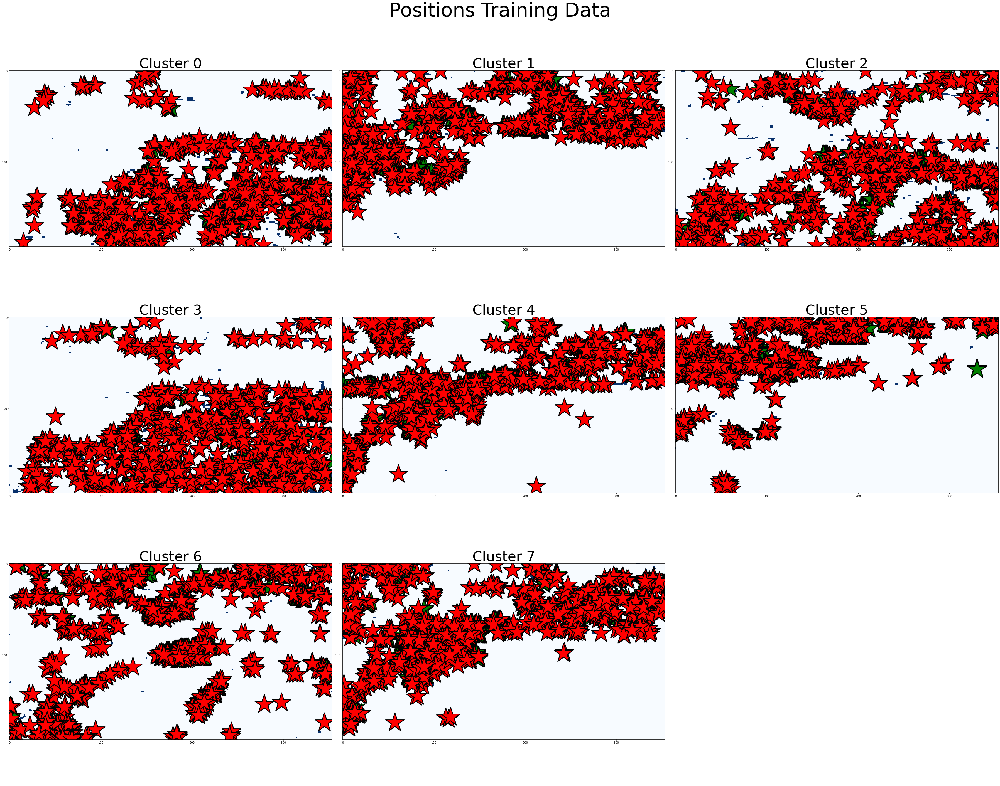

In [26]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(cluster, cmap='Blues', interpolation='nearest')
    for pixel in rep_pix_allCluster[sp]:
        ax.scatter(pixel[1], pixel[0],color = 'green', marker='*', s=5000, edgecolor='black', linewidth=3)
    for pixel in rand_pix_allCluster[sp]:
        ax.scatter(pixel[1], pixel[0],color = 'red', marker='*', s=5000, edgecolor='black', linewidth=3)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/training_pixel_positions.png', format='png', dpi=300)
plt.show()

**GET PIXEL TRAINING DATA**

In [27]:
pixel_training = []
for b in range(len(bands)):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = rep_pix_allCluster[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    pixel_training.append(data)
pixel_training = np.array(pixel_training)
print('bands, clusters, images x pixels')
print(pixel_training.shape)

bands, clusters, images x pixels
(14, 8, 29600)


**SHOW TRAINING DATA: BOXPLOTS**

<Figure size 432x288 with 0 Axes>

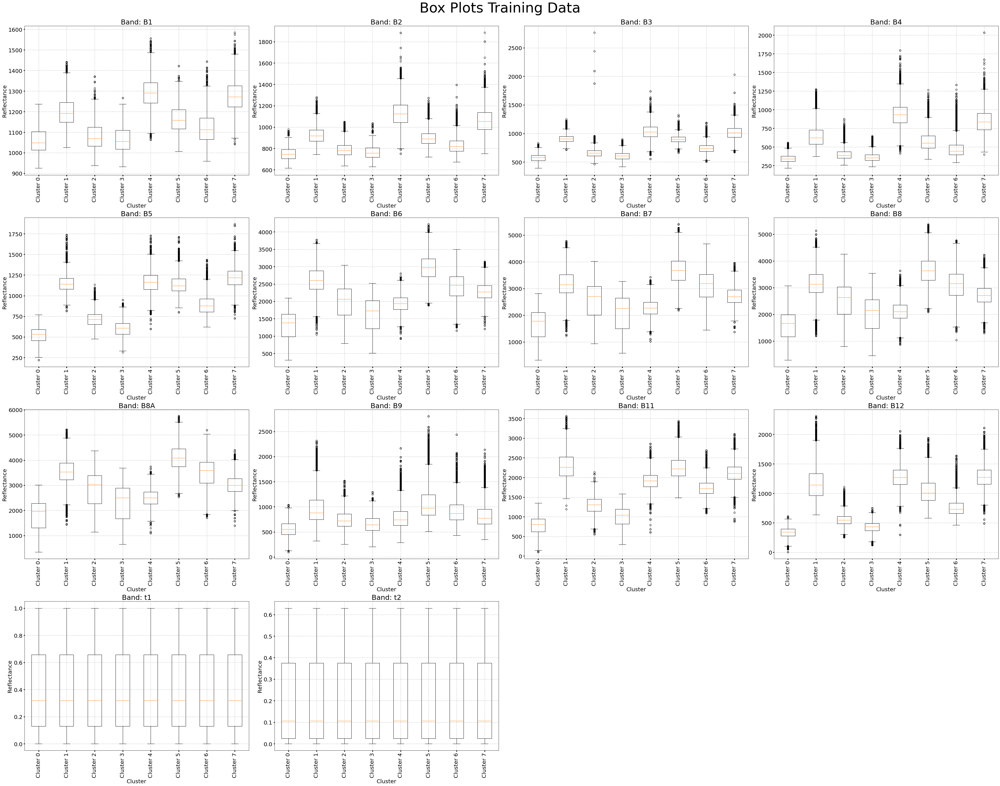

In [28]:
plt.figure()

# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Box Plots Training Data', fontsize = 50)

# Represent Data
for sp in range(n_figures):     
    data = pixel_training[sp]
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/boxplots_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS**

<Figure size 432x288 with 0 Axes>

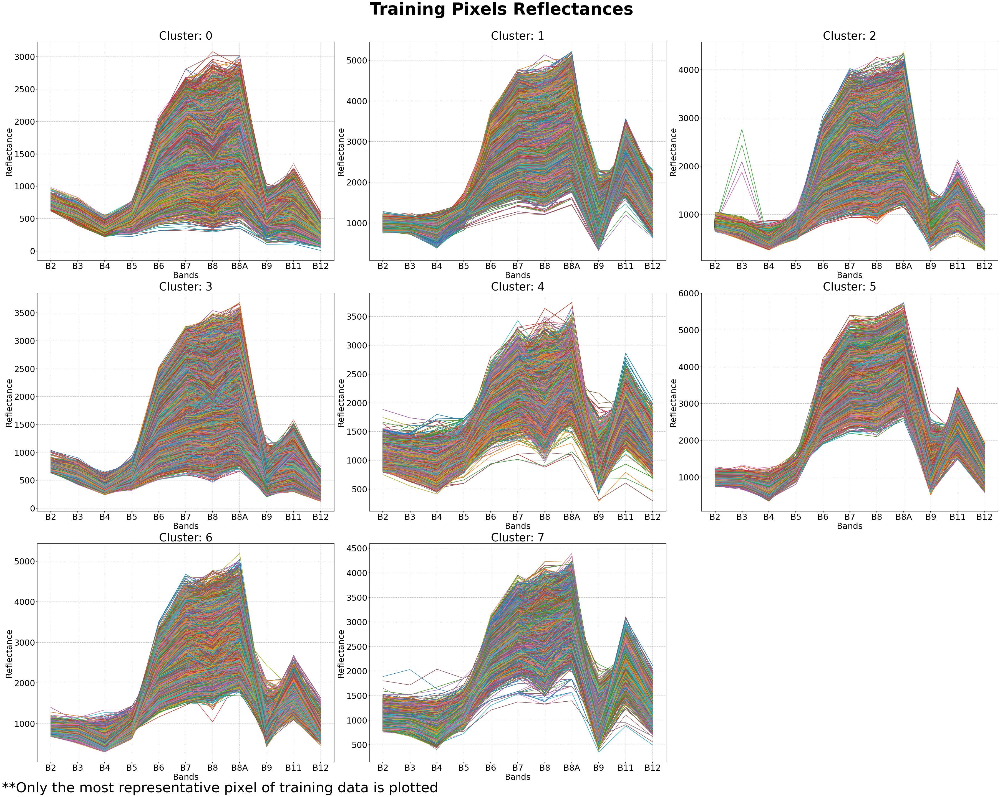

In [29]:
plt.figure()

# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) 
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Training Pixels Reflectances', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = pixel_training[1:-2,sp,:]
    ax = axs[rows[sp], columns[sp]]
    ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('Bands', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=30, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(bands[1:-2]);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# add a comment
textstr = '**Only the most representative pixel of training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShape_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS ALONG TIME**

In [32]:
'''plt.figure()

# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Training Pixels Reflectances along time', fontsize = 60, fontweight="bold")

# Represent Data

for sp in range(n_figures):     
    data = np.transpose(pixel_training[:-2,sp,:])
    ax = axs[rows[sp], columns[sp]]
    im = ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('DOY', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    ax.set_xticks(range(data.shape[0]))
    #ax.set_xticklabels(doys, rotation=90);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()
    
# legend
leg = plt.legend(im, bands[:-2], loc=4, fontsize = 40)

# add a comment
textstr = '**Only the most representative pixel of the training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShapeAlongTime_training.png', format='png', dpi=300)
plt.show()'''

'plt.figure()\n\n# Prepare subplots\nn_figures = n_clusters\nn_rows = int(math.ceil((n_figures)**(1/2)))\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))\nfig.suptitle(f\'Training Pixels Reflectances along time\', fontsize = 60, fontweight="bold")\n\n# Represent Data\n\nfor sp in range(n_figures):     \n    data = np.transpose(pixel_training[:-2,sp,:])\n    ax = axs[rows[sp], columns[sp]]\n    im = ax.plot(data)\n    ax.set_title(f\'Cluster: {sp}\', fontsize=40)\n    ax.set_xlabel(\'DOY\', fontsize=30)\n    ax.set_ylabel(\'Reflectance\', fontsize=30)\n    ax.grid(True, linestyle=\'-.\')\n    ax.tick_params(labelsize=20, width=3)\n    ax.set_xticks(range(data.shape[0]))\n    #ax.set_xticklabels(doys, rotation=90);\n\n# delete empty figures\nfor image in range(n_figures, 

**GET TESTING DATA**

In [30]:
pixel_testing = []
for b in range(len(bands)):
    data = []
    for cluster in range(n_clusters):
        data_cluster = []
        pixels = rand_pix_allCluster[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    pixel_testing.append(data)
pixel_testing = np.array(pixel_testing)
print('bands, clusters, images x pixels')
print(pixel_testing.shape)

bands, clusters, images x pixels
(14, 8, 29600)


# Scale each pixel

- Training pixels: generate scaler and transform

In [33]:
scaler = pp.MinMaxScaler()

pixel_trainingScaled = []    
    
for cluster in range(n_clusters):
    pixel_training_cluster = np.transpose(pixel_training[:, cluster, :]) #images x bands
    pixel_trainingScaled_cluster = scaler.fit_transform(pixel_training_cluster)
    scalers_cluster = os.path.join(model_filepath, f'Scalers/Scaler_{cluster}')
    if not os.path.exists(scalers_cluster):
        os.mkdir(scalers_cluster)
    joblib.dump(scaler, scalers + f'/Scaler_{cluster}/' + '/scale.mod')
    pixel_trainingScaled.append(pixel_trainingScaled_cluster)
    
pixel_trainingScaled = np.array(pixel_trainingScaled)
pixel_trainingScaled.shape # clusters x images x bands

(8, 29600, 14)

- Testing pixels: transform

In [34]:
pixel_testingScaled = []    
    
for cluster in range(n_clusters):
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    pixel_testing_cluster = np.transpose(pixel_testing[:, cluster, :]) #images x bands
    pixel_testingScaled_cluster = scaler_cluster.transform(pixel_testing_cluster)
    pixel_testingScaled.append(pixel_testingScaled_cluster)
    
pixel_testingScaled = np.array(pixel_testingScaled)
pixel_testingScaled.shape # clusters x images x bands

(8, 29600, 14)

---------------------------------------------------------------------------------------------------------

# Autoencoder

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.00013235706137493253
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_0/assets


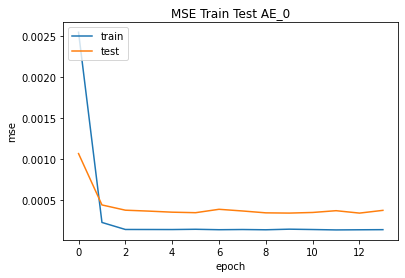

Epoch 00014: early stopping
Min error: 0.0001315078989136964
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_0/assets


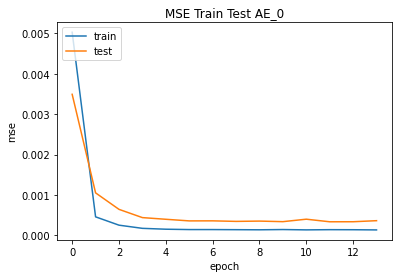

Epoch 00014: early stopping
Min error: 0.00013243821740616113
Epoch 00014: early stopping
Min error: 0.00013182325346861035
Epoch 00014: early stopping
Min error: 0.0001333323452854529
Epoch 00014: early stopping
Min error: 0.00013277881953399628
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001605351862963289
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_1/assets


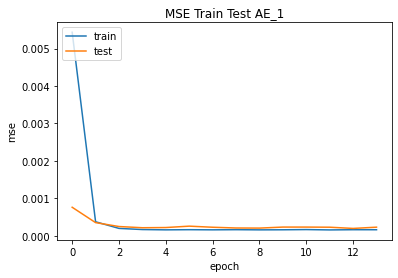

Epoch 00014: early stopping
Min error: 0.00016032671555876732
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_1/assets


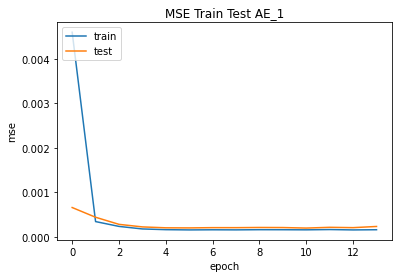

Epoch 00014: early stopping
Min error: 0.00016074816812761128
Epoch 00014: early stopping
Min error: 0.0001626702432986349
Epoch 00014: early stopping
Min error: 0.00016025063814595342
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_1/assets


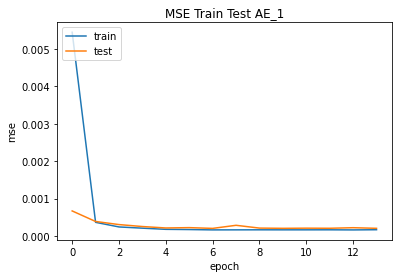

Epoch 00014: early stopping
Min error: 0.00016153349133674055
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001155672871391289
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_2/assets


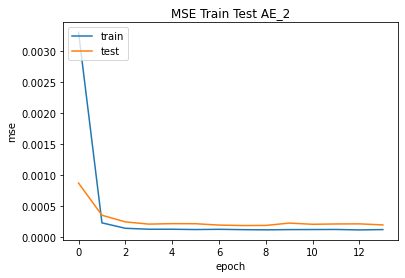

Epoch 00014: early stopping
Min error: 0.00011788038682425395
Epoch 00014: early stopping
Min error: 0.00011668718798318878
Epoch 00014: early stopping
Min error: 0.00011784664093283936
Epoch 00014: early stopping
Min error: 0.0001161515829153359
Epoch 00014: early stopping
Min error: 0.00011621067096712068
-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.00012813902867492288
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_3/assets


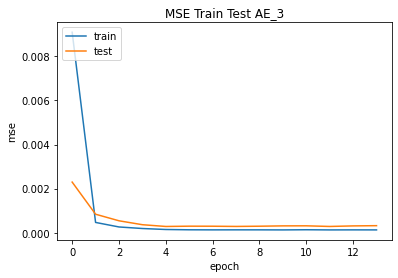

Epoch 00014: early stopping
Min error: 0.00012823154975194484
Epoch 00014: early stopping
Min error: 0.00012925095506943762
Epoch 00014: early stopping
Min error: 0.00012989489187020808
Epoch 00014: early stopping
Min error: 0.00012665790563914925
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_3/assets


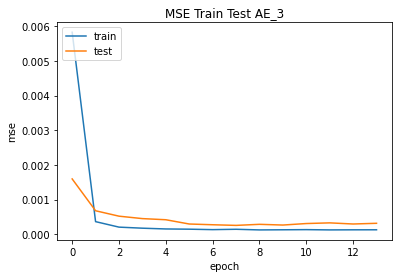

Epoch 00014: early stopping
Min error: 0.00012683427485171705
-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.00031849020160734653
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_4/assets


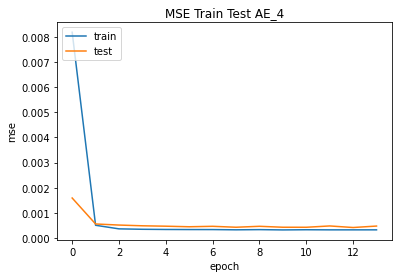

Epoch 00014: early stopping
Min error: 0.00031986855901777744
Epoch 00014: early stopping
Min error: 0.0003163011569995433
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_4/assets


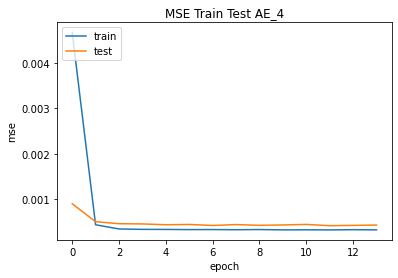

Epoch 00014: early stopping
Min error: 0.00031942318310029805
Epoch 00014: early stopping
Min error: 0.0003266520507168025
Epoch 00014: early stopping
Min error: 0.0003176582686137408
-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001599529932718724
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


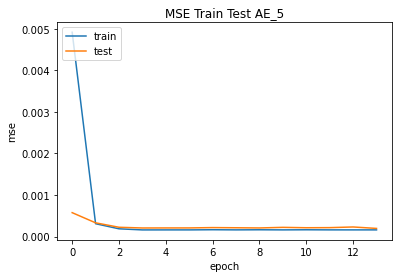

Epoch 00014: early stopping
Min error: 0.00015940549201332033
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


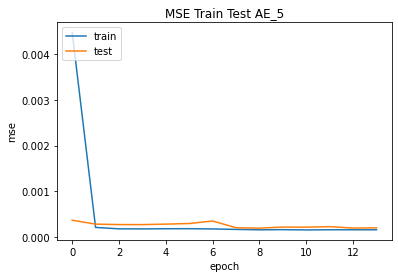

Epoch 00014: early stopping
Min error: 0.00016099971253424883
Epoch 00014: early stopping
Min error: 0.00016081213834695518
Epoch 00014: early stopping
Min error: 0.00015683502715546638
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


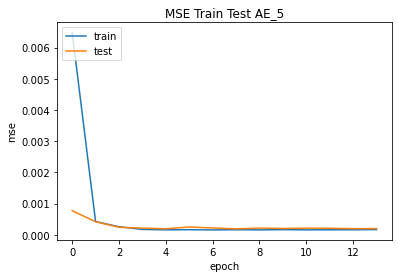

Epoch 00014: early stopping
Min error: 0.00015357945812866092
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


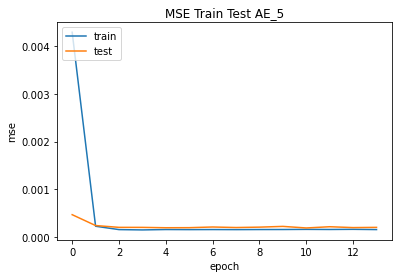

-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001856630260590464
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


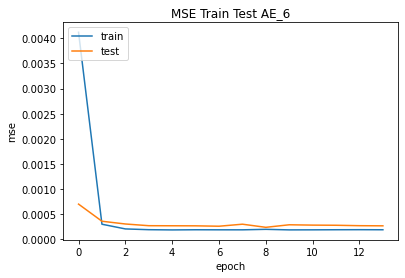

Epoch 00014: early stopping
Min error: 0.00018545392958912998
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


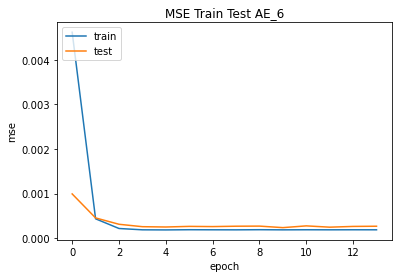

Epoch 00014: early stopping
Min error: 0.00018484918109606951
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


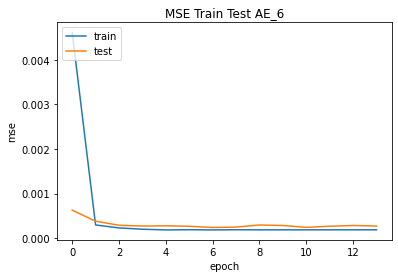

Epoch 00014: early stopping
Min error: 0.00018574779096525162
Epoch 00014: early stopping
Min error: 0.00018394834478385746
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


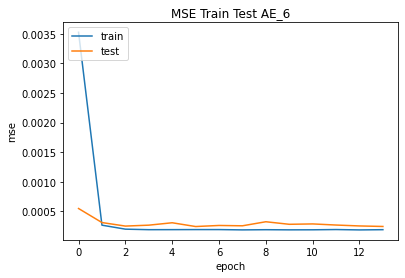

Epoch 00014: early stopping
Min error: 0.0001849638792918995
-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0002543197479099035
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_7/assets


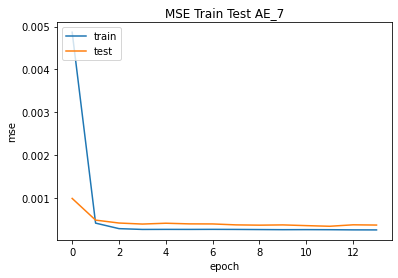

Epoch 00014: early stopping
Min error: 0.0002475147193763405
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_7/assets


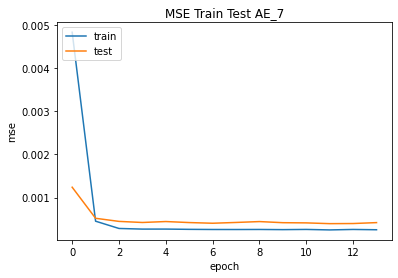

Epoch 00014: early stopping
Min error: 0.00025138500495813787
Epoch 00014: early stopping
Min error: 0.0002484059950802475
Epoch 00014: early stopping
Min error: 0.0002504502481315285
Epoch 00014: early stopping
Min error: 0.00024864712031558156
Running time AEs --- minutes ----17.837945302327473


In [35]:
# early stopping
es = keras.callbacks.EarlyStopping(monitor = 'mse', mode = 'min', min_delta = 0.001, verbose = 2, patience = 12) 

start = time.time()

for ae in range(n_clusters):

    lowest_error = 100000000

    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')

    ## Create a folder for the AE
    # Model filepaths
    folder = f'Autoencoder_{ae}'
    mf = os.path.join(model_filepath, folder)
    if not os.path.exists(mf):
          os.mkdir(mf)
    # Figures filepaths
    mf2 = os.path.join(figures_filepath, 'Training')
    if not os.path.exists(mf2):
          os.mkdir(mf2)
    mf3 = os.path.join(figures_filepath, 'Error')
    if not os.path.exists(mf3):
          os.mkdir(mf3)
    mf4 = os.path.join(figures_filepath, 'Reflectance')
    if not os.path.exists(mf4):
          os.mkdir(mf4)


    ## Prepare training data
    print('Preparing training data...')

    
    # Data of the selected pixels
    pixel_trainingScaled_cluster = pixel_trainingScaled[ae]
    pixel_testingScaled_cluster = pixel_testingScaled[ae]


    ## Train AE
    print('Training the model...')
    for n in range(6):
        # Create model
        model = Sequential()

        # Create layers
        model.add(Dense(units=n_hidden_neurons, activation='linear', input_dim=len(bands)))
        model.add(Dense(units=len(bands), activation='linear'))

        # Compile model (a traditional default value for the learning rate is 0.1 or 0.01)
        opt = keras.optimizers.Adam(learning_rate=0.01)
        tf.keras.losses.MeanSquaredError(reduction="auto", name="mean_squared_error")
        model.compile(optimizer=opt, loss="mean_squared_error", metrics=['mse'])

        # Train
        X_train = pixel_trainingScaled_cluster
        X_test = pixel_testingScaled_cluster
        history = model.fit(x=X_train, y=X_train,
                            epochs=200,
                            batch_size= None,
                            shuffle=True,
                            validation_data=(X_test,X_test),
                            verbose=0,
                            callbacks=[es])

        # Save best model
        error = min(history.history['mse'])
        print(f'Min error: {error}')

        if error < lowest_error:
            lowest_error = error
            model.save(mf, overwrite=True, include_optimizer=True)
            # Plot train-test curves
            plt.plot(history.history['mse'])
            plt.plot(history.history['val_mse'])
            plt.title(f'MSE Train Test AE_{ae}')
            plt.ylabel('mse')
            plt.xlabel('epoch')
            plt.legend(['train', 'test'], loc='upper left')
            plt.savefig(f'{mf2}/traintestCurvesAE_{ae}.png', format='png', dpi=300)
            plt.show()
        pass

end = time.time()

print(f'Running time AEs --- minutes ----{(end-start)/60}')

# Predictions

In [36]:
# Figures filepaths
mf2 = os.path.join(figures_filepath, 'Training')
mf3 = os.path.join(figures_filepath, 'Error')
mf4 = os.path.join(figures_filepath, 'Reflectance')

# RECONSTRUCT TRAINING DATA

In [37]:
scalers = os.path.join(model_filepath, 'Scalers')
reconstruction = []

for ae in list(range(n_clusters)):
    
    # Upload models
    mf = f'{model_filepath}/Autoencoder_{ae}/'
    model = keras.models.load_model(mf)
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    
    # Scale
    trainScaled_AE = scaler_cluster.transform(train_AE)
    
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    recScaled_AE = model.predict(x=trainScaled_AE, verbose=1)
    
    # Descale
    reconstruction_AE = scaler_cluster.inverse_transform(recScaled_AE)
    
    # Convert to original shape
    reconstruction_cluster = reconstruction_AE.transpose()
    reconstruction_cluster = reconstruction_cluster.reshape(training.shape[1], training.shape[0], training.shape[2], training.shape[3])
    images = []
    for img in range(training.shape[0]):
        bands_img = []
        for b in range(training.shape[1]):
            band = reconstruction_cluster[b, img, :, :]
            bands_img.append(band)
        images.append(bands_img)
    reconstruction_cluster = np.array(images)
    reconstruction.append(reconstruction_cluster)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

reconstruction = np.array(reconstruction)

Predicting autoencoder 0...
78998/78998 [==============================] - 80s 1ms/step
Prediction time AE_0 ---minutes--- 1.3769303242365518
Predicting autoencoder 1...
78998/78998 [==============================] - 65s 825us/step
Prediction time AE_1 ---minutes--- 1.1001774668693542
Predicting autoencoder 2...
78998/78998 [==============================] - 83s 1ms/step
Prediction time AE_2 ---minutes--- 1.391375994682312
Predicting autoencoder 3...
78998/78998 [==============================] - 72s 916us/step
Prediction time AE_3 ---minutes--- 1.2186731338500976
Predicting autoencoder 4...
78998/78998 [==============================] - 61s 765us/step
Prediction time AE_4 ---minutes--- 1.0201931873957315
Predicting autoencoder 5...
78998/78998 [==============================] - 67s 853us/step
Prediction time AE_5 ---minutes--- 1.1358412384986878
Predicting autoencoder 6...
78998/78998 [==============================] - 65s 821us/step
Prediction time AE_6 ---minutes--- 1.09482143322626

**SHOW PIXEL RECONSTRUCTION (MOST REPRESENTATIVE PIXEL PER CLUSTER)**

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------


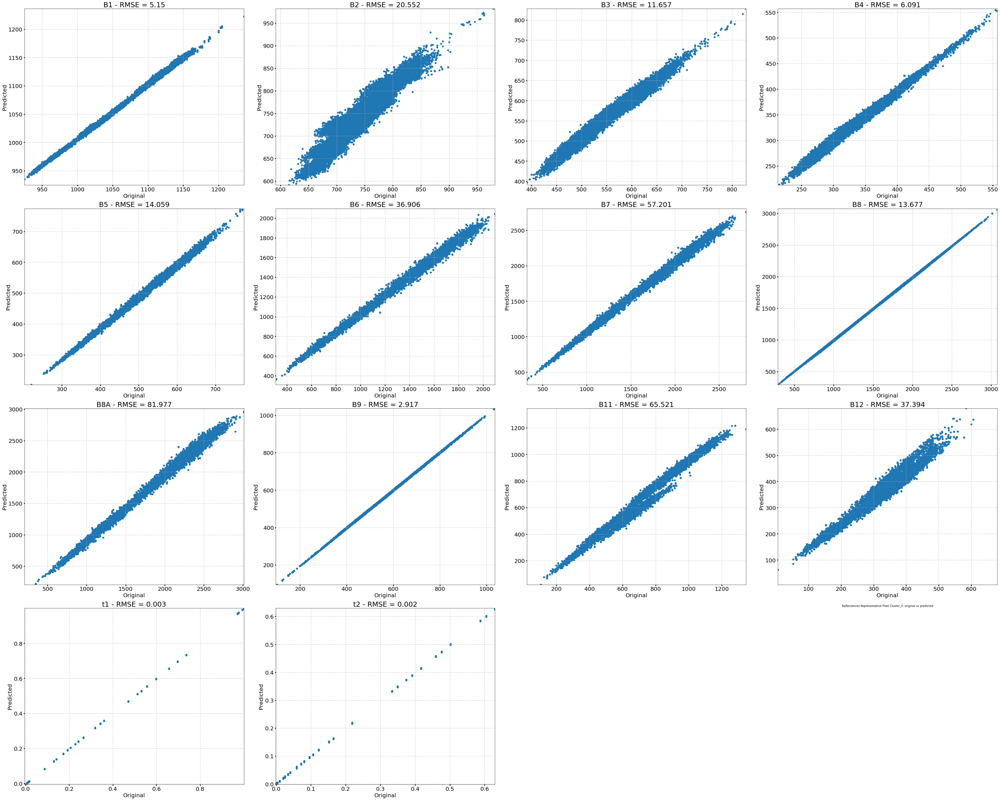

Sum RMSE all bands...
Total RMSE autoencoder 0: 353.107
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------


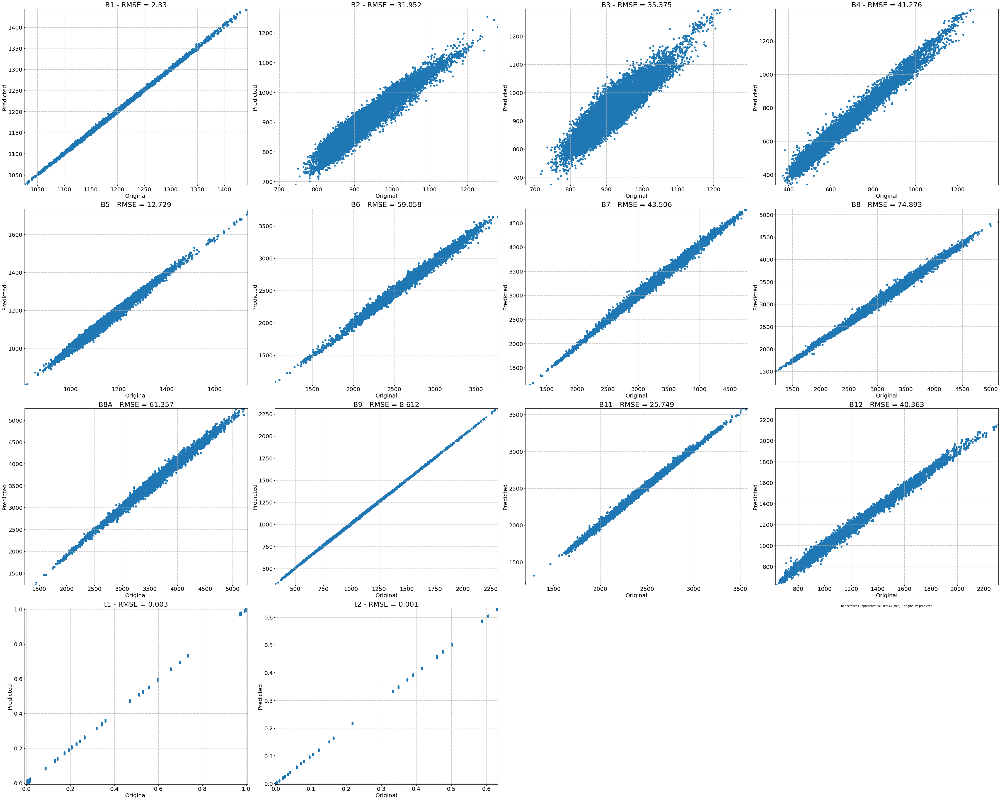

Sum RMSE all bands...
Total RMSE autoencoder 1: 437.204
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------


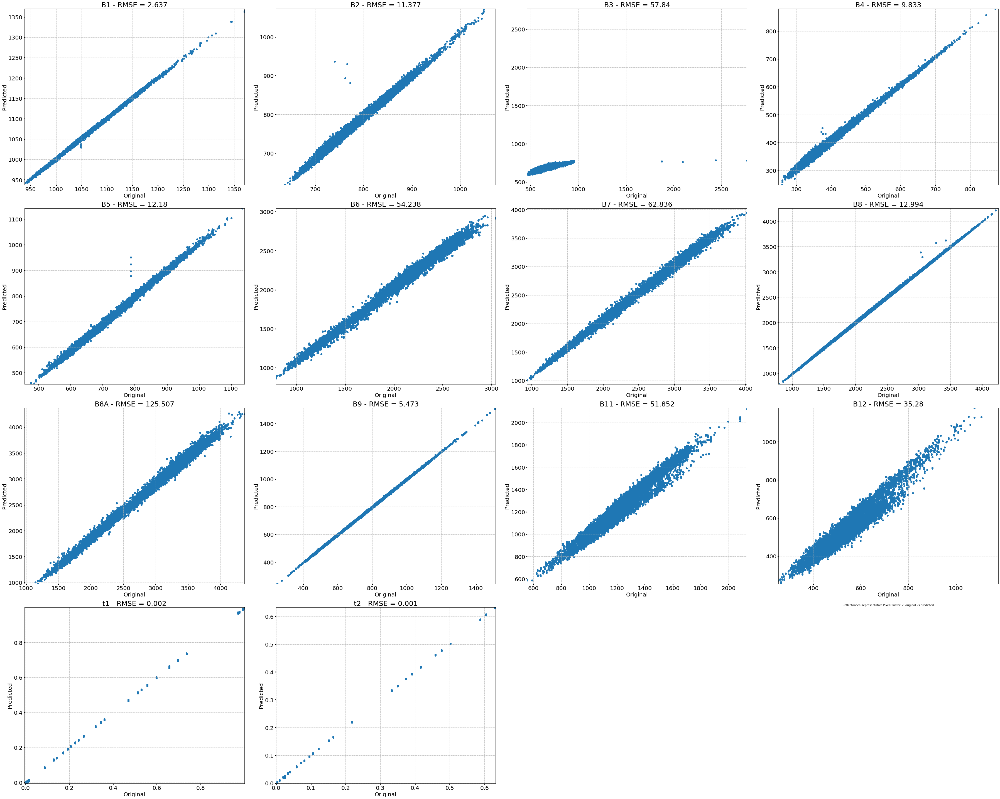

Sum RMSE all bands...
Total RMSE autoencoder 2: 442.05
-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------


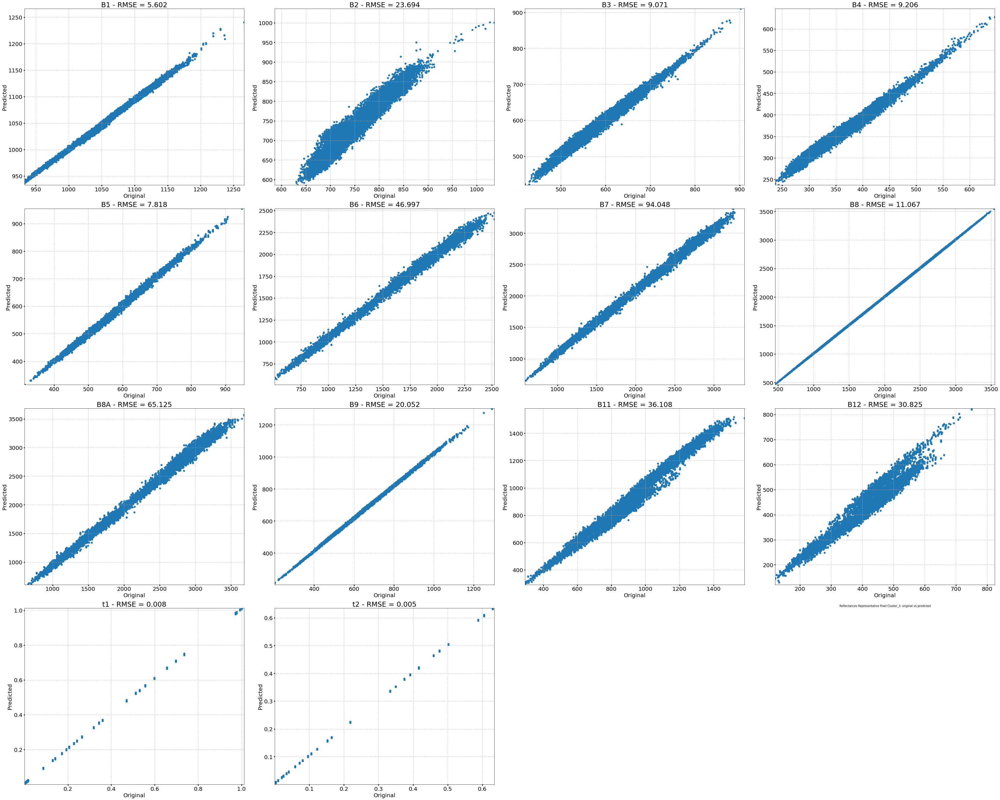

Sum RMSE all bands...
Total RMSE autoencoder 3: 359.62600000000003
-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------


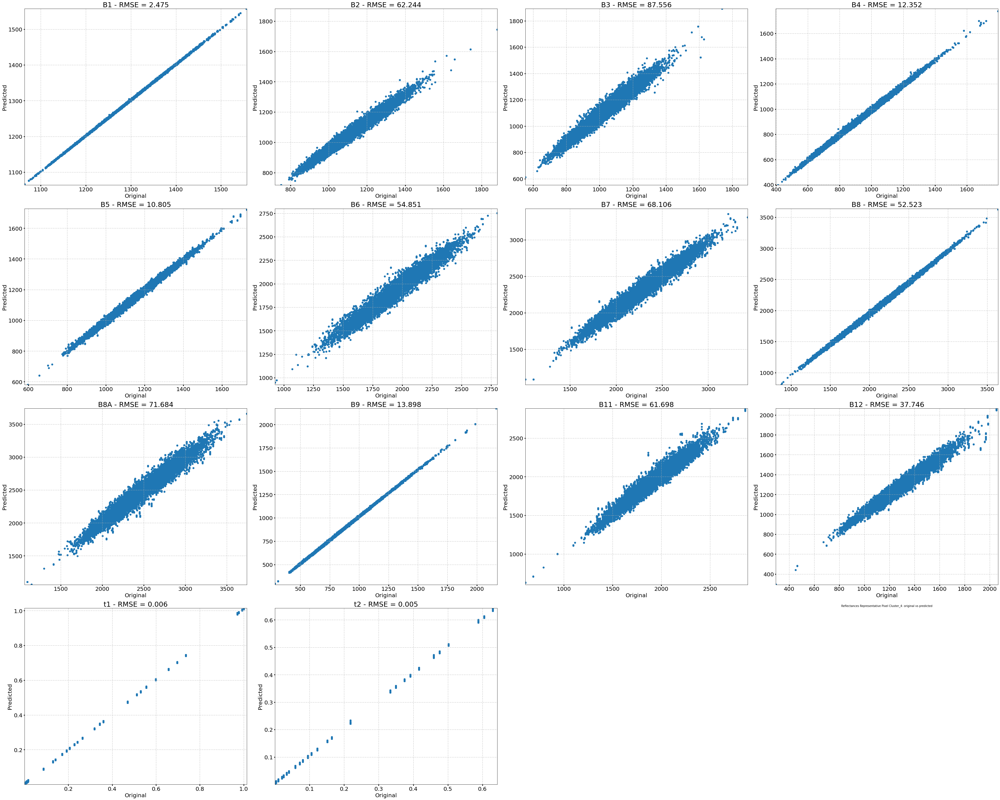

Sum RMSE all bands...
Total RMSE autoencoder 4: 535.949
-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------


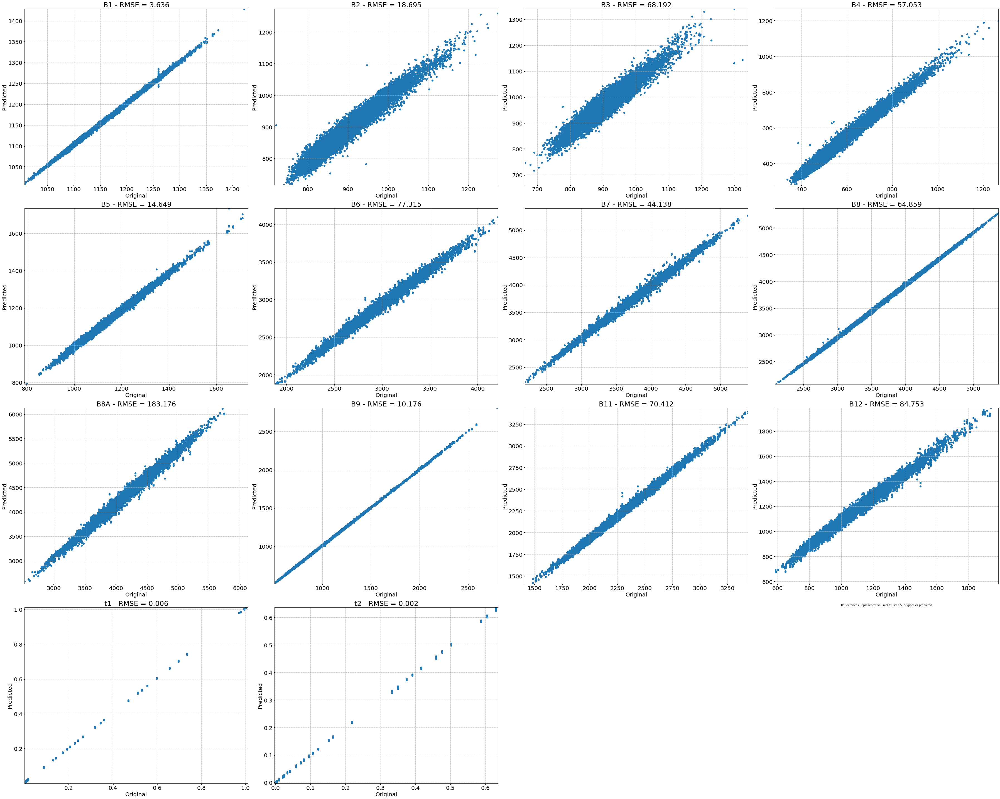

Sum RMSE all bands...
Total RMSE autoencoder 5: 697.062
-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------


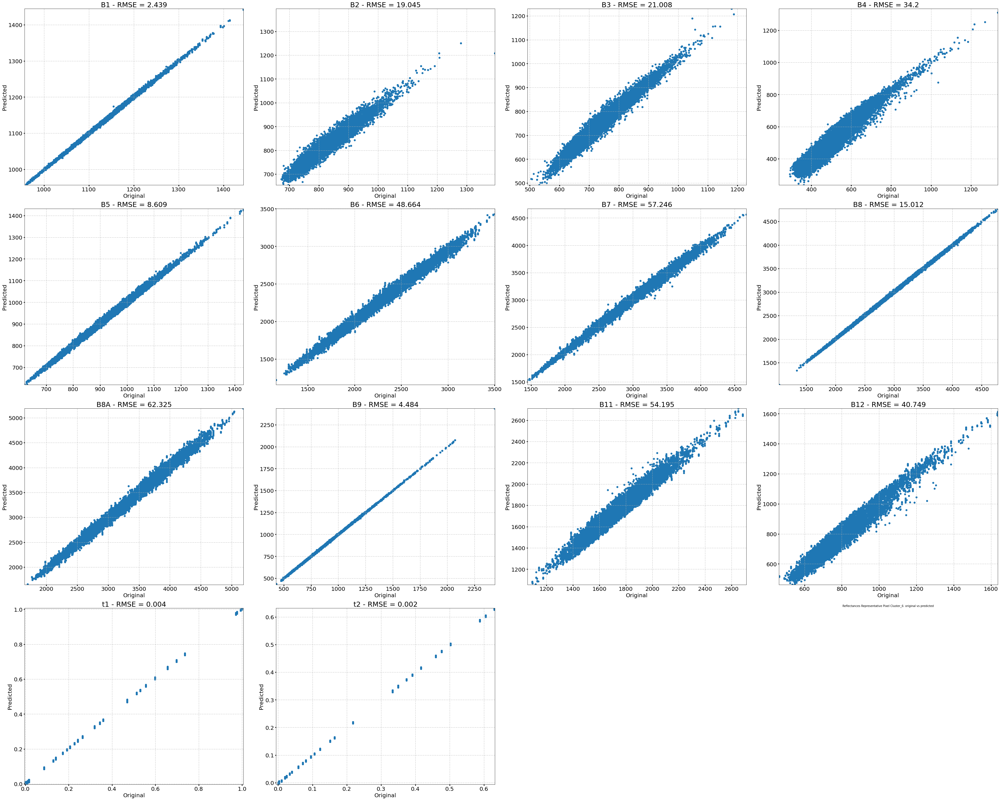

Sum RMSE all bands...
Total RMSE autoencoder 6: 367.982
-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------


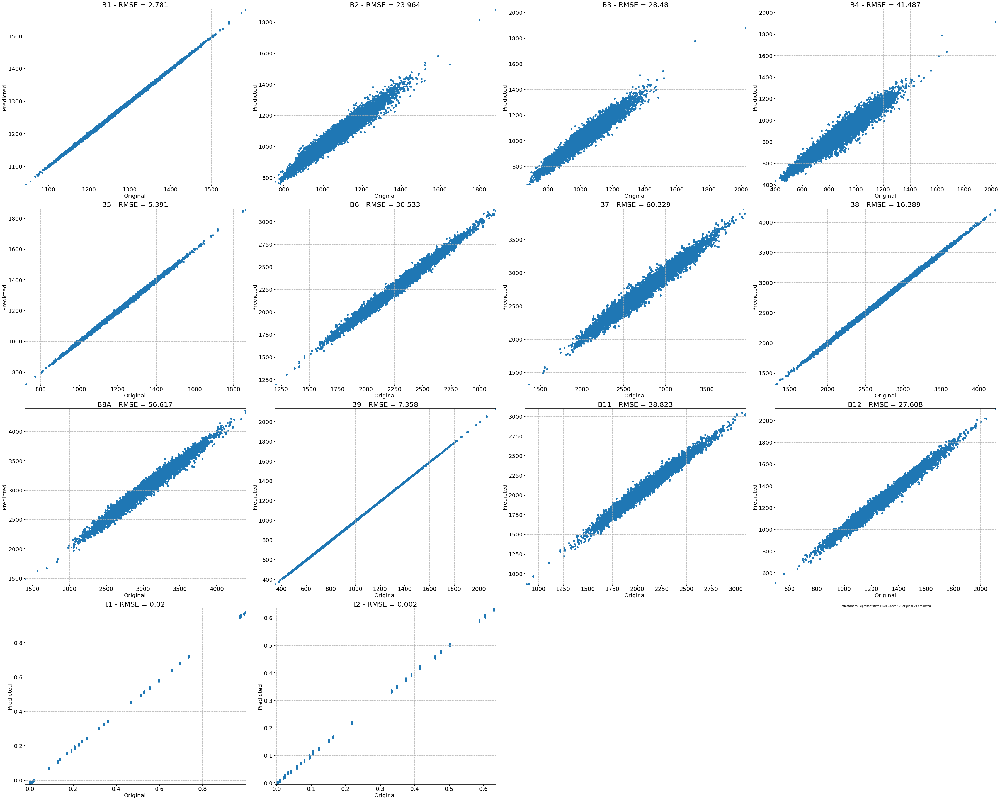

Sum RMSE all bands...
Total RMSE autoencoder 7: 339.782


In [38]:
from matplotlib.cbook import flatten
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Show reflectances for each AE
for ae in range(n_clusters):
    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')
    
    # Plot reflectances original pixel vs. reconstructed
    reconstruction_cluster = reconstruction[ae]
    pixels = rep_pix_allCluster[ae]
    pixel = pixels[0]
    fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
    rms_l = []
    
    # reflectance bands: B1, B2, B3, B4, B5
    for sp in range(n_figures):
        ori_sublist = []
        pre_sublist = []
        for pixel in pixels:
            ori_pixel = list(training[:,sp, pixel[0], pixel[1]])
            ori_sublist.append(ori_pixel)
            pre_pixel = list(reconstruction_cluster[:,sp, pixel[0], pixel[1]])
            pre_sublist.append(pre_pixel)
        #print(ori_sublist)
        #print(pre_sublist)
        ori = list(flatten(ori_sublist))
        pre = list(flatten(pre_sublist))
        rms = round(mean_squared_error(ori, pre, squared=False),3)
        rms_l.append(rms)
        ax = axs[rows[sp], columns[sp]]
        im = ax.scatter(ori, pre)
        ax.set_xlim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_ylim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_title(f'{bands[sp]} - RMSE = {rms}', fontsize=25)
        ax.set_xlabel('Original', fontsize=20)
        ax.set_ylabel('Predicted', fontsize=20)
        ax.grid(True, linestyle='-.')
        ax.tick_params(labelsize=20, width=3)
    
    # delete empty figures
    for sp in range(n_figures, n_rows*n_cols):
        axs[rows[sp], columns[sp]].set_axis_off()

    plt.title(f'Reflectances Representative Pixel Cluster_{ae}: original vs predicted', fontsize=10)
    plt.tight_layout()
    plt.savefig(f'{mf4}/OriginalvsReconstructed_AE_{ae}.png', format='png', dpi=300)
    plt.show()
    
    # print total RMSE
    print('Sum RMSE all bands...')
    print(f'Total RMSE autoencoder {ae}: {np.sum(np.array(rms_l))}')
    
    # save RMSE
    dict = {'RMSE' : np.sum(np.array(rms_l))}
    f = open( f'{model_filepath}/RMSE_pixel_training_reconstruction.txt', 'w')
    f.write( repr(dict) + '\n' )
    f.close()

# PREDICT TEST DATA

In [39]:
scalers = os.path.join(model_filepath, 'Scalers')
prediction = []

for ae in list(range(n_clusters)):
    
    # Upload models
    mf = f'{model_filepath}/Autoencoder_{ae}/'
    model = keras.models.load_model(mf)
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    
    # Scale
    testScaled_AE = scaler_cluster.transform(test_AE)
    
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    predScaled_AE = model.predict(x=testScaled_AE, verbose=1)
    
    # Descale
    prediction_AE = scaler_cluster.inverse_transform(predScaled_AE)

    # Convert to original shape
    prediction_cluster = prediction_AE.transpose()
    prediction_cluster = prediction_cluster. reshape(testing.shape[0], testing.shape[1], testing.shape[2])
    prediction.append(prediction_cluster)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

prediction = np.array(prediction)

Predicting autoencoder 0...
2136/2136 [==============================] - 2s 1ms/step
Prediction time AE_0 ---minutes--- 0.03804523150126139
Predicting autoencoder 1...
2136/2136 [==============================] - 2s 856us/step
Prediction time AE_1 ---minutes--- 0.03200306495030721
Predicting autoencoder 2...
2136/2136 [==============================] - 2s 956us/step
Prediction time AE_2 ---minutes--- 0.03588738441467285
Predicting autoencoder 3...
2136/2136 [==============================] - 2s 889us/step
Prediction time AE_3 ---minutes--- 0.03323607047398885
Predicting autoencoder 4...
2136/2136 [==============================] - 1s 485us/step
Prediction time AE_4 ---minutes--- 0.018885338306427003
Predicting autoencoder 5...
2136/2136 [==============================] - 2s 892us/step
Prediction time AE_5 ---minutes--- 0.03346958160400391
Predicting autoencoder 6...
2136/2136 [==============================] - 1s 567us/step
Prediction time AE_6 ---minutes--- 0.021824618180592854
Predic

**Calculate error: RMSE (with scaled values)**

In [40]:
error_list = []
ae=0
for prediction_cluster in prediction:    
    print(f'Calculating error autoencoder {ae}...')
    ae=ae+1
    
    # RMSE y=bands of one image -> predicted vs original + mean of the RMSE between all images
    dif = (prediction_cluster[:-2,:,:]-testing[:-2,:,:])**2
    suma = np.sum(dif, axis = 0)
    div = suma/(testing.shape[0]-2)
    square = div**(1/2)
    error_list.append(square)

error_list = np.array(error_list)

Calculating error autoencoder 0...
Calculating error autoencoder 1...
Calculating error autoencoder 2...
Calculating error autoencoder 3...
Calculating error autoencoder 4...
Calculating error autoencoder 5...
Calculating error autoencoder 6...
Calculating error autoencoder 7...


**Plot error**

In [41]:
##hyperparameters (visualization)
vmin= 0
vmax= 100

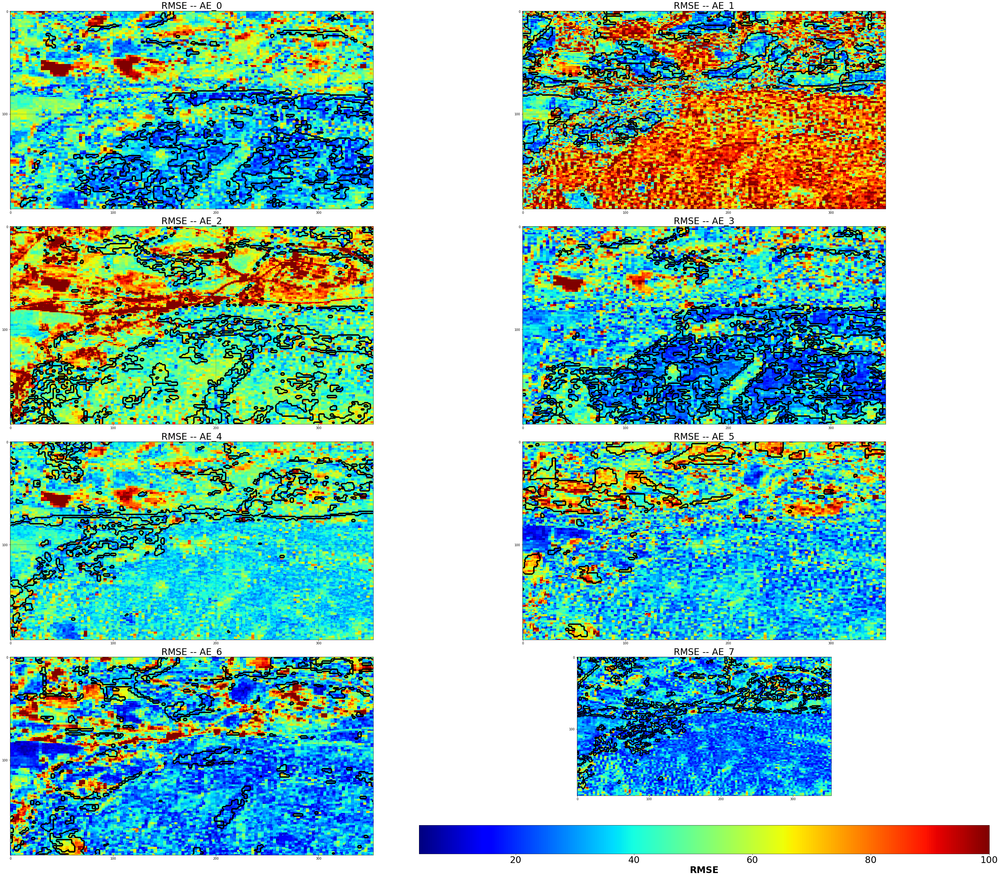

In [42]:
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) +1
n_cols = int(math.ceil(n_figures/n_rows))
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# RMSE in each subplot: plot error matrices
cm = 'jet'
for ae in range(n_figures):
    mean = error_list[ae]
    cluster = labels==ae
    ax = axs[rows[ae], columns[ae]]
    im = ax.imshow(mean, cmap=cm, vmax=100)
    ax.contour(cluster, colors='black', linewidths=1.5)
    ax.set_xticks(np.arange(mean.shape[1]+1, step=100))
    ax.set_yticks(np.arange(mean.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{ae}', fontsize=30)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
plt.tight_layout()
#plt.savefig(f'{mf3}/RMSE_all_AE.png', format='png', dpi=300)
plt.show()

**Min Error of All Autoencoders in AOI**

In [57]:
##hyperparameters (visualization)
vmin1= 0
vmax1= 10

-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------


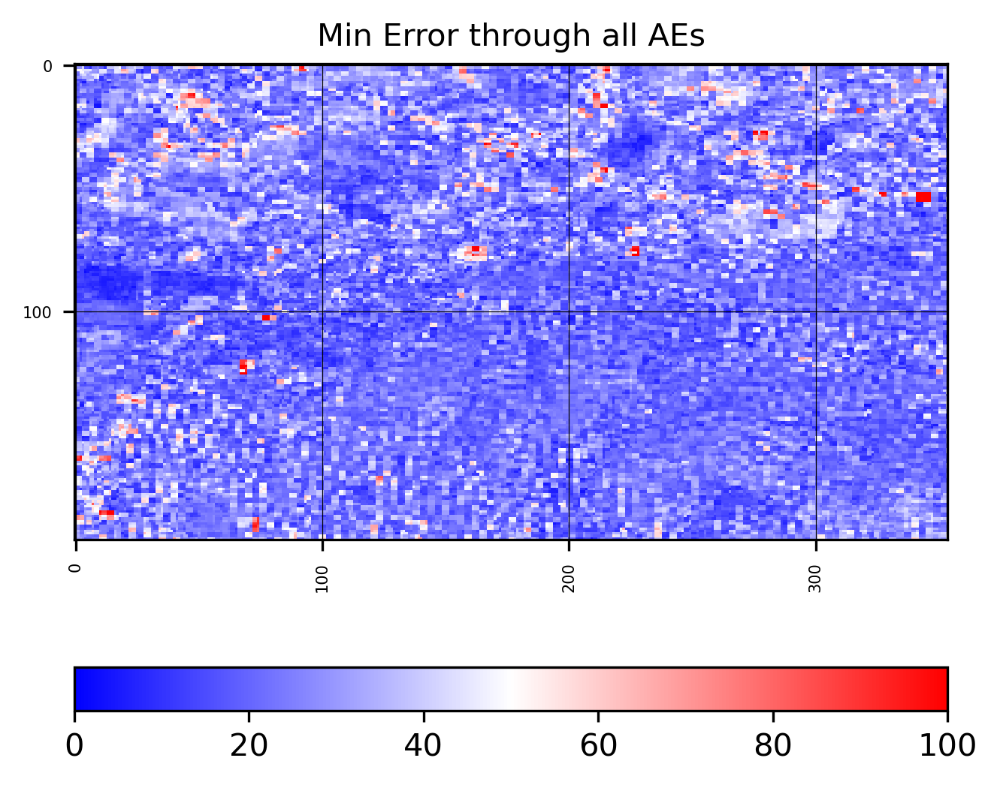

In [44]:
## Min Error of All Autoencoders
print(f'''-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------''')
error = error_list.min(axis=0)
# Plot min error
fig, ax = plt.subplots(figsize=(5,5), dpi=300)
ax = plt.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin1, vmax=vmax1)
plt.xticks(np.arange(error.shape[1]+1, step=100), fontsize=5, rotation=90)
plt.yticks(np.arange(error.shape[0]+1, step=100), fontsize=5, rotation=0)
plt.grid(color='black', linewidth=0.3)
plt.title(f'Min Error through all AEs', fontsize=10)
fig.colorbar(ax, orientation='horizontal')
#plt.savefig(f'{mf3}/min_error.png', format='png', dpi=300)
plt.show()

**REPRESENT MIN ERROR BOUNDING CLUSTERS**

<Figure size 432x288 with 0 Axes>

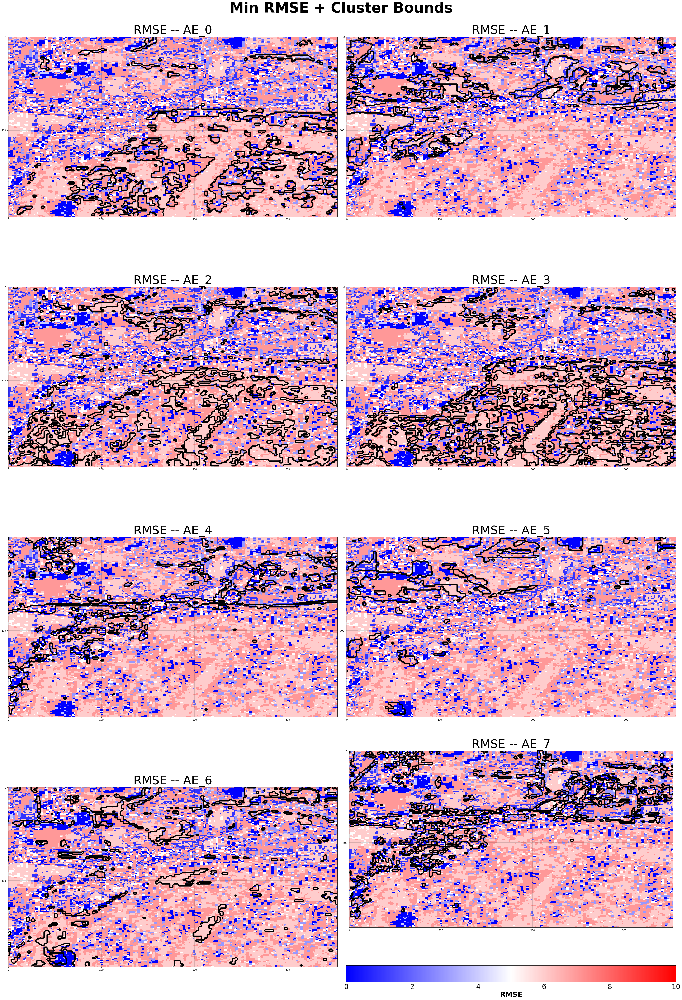

In [58]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = 4 
n_cols = 2
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Min RMSE + Cluster Bounds', fontsize = 60, fontweight="bold")

# RMSE in each subplot: plot error matrices
cm = 'jet'
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    im = ax.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin1, vmax=vmax1)
    ax.contour(cluster, colors='black', linewidths=2)
    ax.set_xticks(np.arange(error.shape[1]+1, step=100))
    ax.set_yticks(np.arange(error.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
fig.subplots_adjust(top=0.9)
plt.tight_layout()
plt.savefig(f'{mf3}/minRMSE_ClusterBounds.png', format='png', dpi=300)
plt.show()

# Reconstruction

**AUTOENCODERS**

In [47]:
# Autoencoder of each pixel
for y in range(testing.shape[1]):
    for x in range(testing.shape[2]):
        for c in range(n_clusters):
            if error[y,x] == error_list[c, y, x]:
                error[y,x] = c
            else:
                pass

<Figure size 432x288 with 0 Axes>

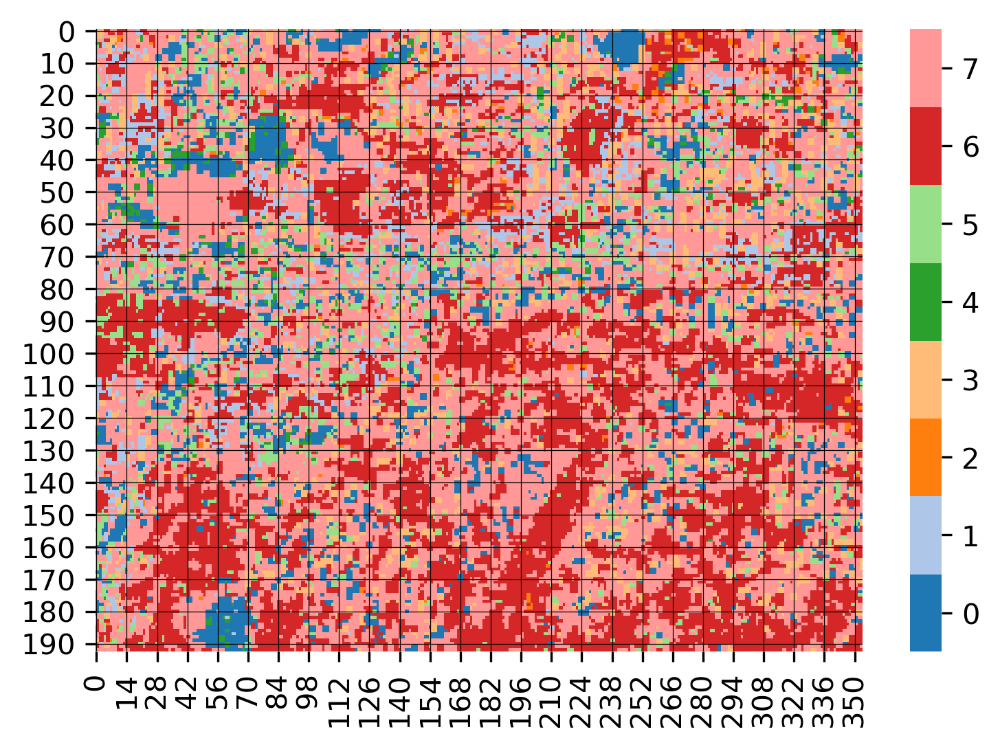

In [48]:
plt.figure()

# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(error, cmap=cmap) 

# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)

#save and plot
plt.savefig(f'{figures_filepath}/Clusters_Autoencoders.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE**

In [49]:
best_pred = []
for c in range(n_clusters):
    cluster = error == c
    prediction_cluster = prediction[c]
    pred_cluster = cluster * prediction_cluster
    best_pred.append(pred_cluster)
best_pred = np.array(best_pred)
best_pred = np.sum(best_pred, axis = 0)
best_pred.shape

(14, 193, 354)

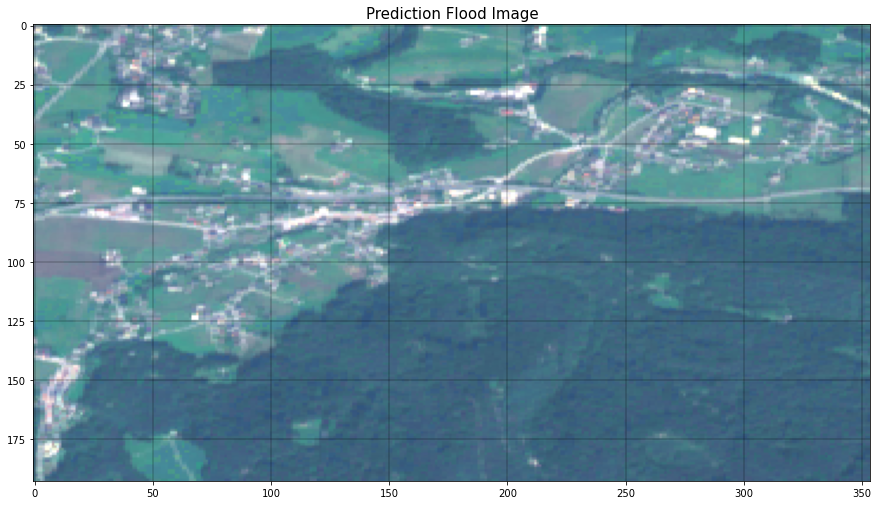

In [50]:
plt.figure(figsize = (15,15))
image = best_pred
img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'Prediction Flood Image', fontsize=15)
plt.savefig(f'{figures_filepath}/reconstruction_TCC.png', format='png', dpi=300)
plt.show()

# End :)